In [1]:
import re
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
import folium
import geodatasets

from sklearn.model_selection import train_test_split
import geopandas as gpd
from shapely.geometry import Point, Polygon
from matplotlib_scalebar.scalebar import ScaleBar
from sklearn.metrics import accuracy_score, confusion_matrix, matthews_corrcoef, roc_curve
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GRU, Embedding
from tensorflow.keras.optimizers import Adam,SGD,RMSprop  
from tensorflow.keras.callbacks import EarlyStopping

#from pytoc import TOC, TOC_painter

from sklearn.neural_network import MLPClassifier

from imblearn.under_sampling import RandomUnderSampler
import toc

2024-06-06 21:10:21.474795: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-06 21:10:21.513736: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
X_train = pd.read_csv("/home/jupyter-fnateras2/Experimentos_lib_R/Morelia_train_X.csv", header = 0)
Y_train = pd.read_csv("/home/jupyter-fnateras2/Experimentos_lib_R/Morelia_train_Y.csv", header = 0)

In [4]:
X_test = pd.read_csv("/home/jupyter-fnateras2/Experimentos_lib_R/Morelia_validation_X.csv", header = 0)
Y_test = pd.read_csv("/home/jupyter-fnateras2/Experimentos_lib_R/Morelia_validation_Y.csv", header = 0)

In [5]:
undersampler = RandomUnderSampler()

In [6]:
X_train_resampled, y_train_resampled = undersampler.fit_resample(X_train.iloc[:,3:], Y_train.iloc[:,-1])

### MLP

In [7]:
inputs = keras.Input(shape=(np.shape(X_train_resampled)[1],), name='input')
x = tf.keras.layers.Dense(150, activation='sigmoid')(inputs)
x = tf.keras.layers.Dense(100, activation='sigmoid')(x)
x = tf.keras.layers.Dense(50, activation='sigmoid')(x)
#x = tf.keras.layers.Dense(2, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

callback = tf.keras.callbacks.EarlyStopping(monitor = 'loss', patience = 5)

MLP = tf.keras.Model(inputs=inputs, outputs=outputs)

MLP.compile(optimizer = 'adam',
            loss = 'binary_crossentropy',
            #loss = CustomAccuracy(),
            #metrics = 'binary_crossentropy'
            metrics = 'binary_crossentropy'
            )

history_mlp = MLP.fit(X_train_resampled, y_train_resampled, validation_data=(X_test.iloc[:,3:], Y_test.iloc[:,-1]),  callbacks=[callback] , epochs = 10000, batch_size = int(len(y_train_resampled)*0.5))


Epoch 1/10000
2/2 [==============================] - 1s 438ms/step - loss: 0.6990 - binary_crossentropy: 0.6990 - val_loss: 0.7250 - val_binary_crossentropy: 0.7250
Epoch 2/10000
2/2 [==============================] - 0s 272ms/step - loss: 0.6899 - binary_crossentropy: 0.6899 - val_loss: 0.7248 - val_binary_crossentropy: 0.7248
Epoch 3/10000
2/2 [==============================] - 0s 275ms/step - loss: 0.6811 - binary_crossentropy: 0.6811 - val_loss: 0.6798 - val_binary_crossentropy: 0.6798
Epoch 4/10000
2/2 [==============================] - 0s 268ms/step - loss: 0.6719 - binary_crossentropy: 0.6719 - val_loss: 0.6438 - val_binary_crossentropy: 0.6438
Epoch 5/10000
2/2 [==============================] - 0s 244ms/step - loss: 0.6630 - binary_crossentropy: 0.6630 - val_loss: 0.6348 - val_binary_crossentropy: 0.6348
Epoch 6/10000
2/2 [==============================] - 0s 268ms/step - loss: 0.6530 - binary_crossentropy: 0.6530 - val_loss: 0.6443 - val_binary_crossentropy: 0.6443
Epoch 7/10

In [10]:
plt.rcParams['figure.figsize'] = [7, 7]

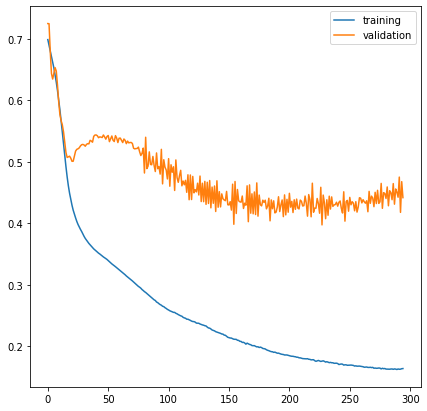

In [11]:
plt.plot(history_mlp.history["loss"], label = "training")
plt.plot(history_mlp.history["val_loss"], label = "validation")
plt.legend()
plt.show()

### Matriz de confusión entrenamiento

In [12]:
yhat_train_mlp = MLP.predict(X_train.iloc[:,3:])
yhat_valid_mlp = MLP.predict(X_test.iloc[:,3:])

31313/31313 [==============================] - 33s 1ms/step


In [13]:
pred_round_train=[]
for i in range(len(yhat_train_mlp)):
    if yhat_train_mlp[i]>=0.5:
        pred_round_train.append(1)
    else:
        pred_round_train.append(0)

In [14]:
cm_train = confusion_matrix(pred_round_train, Y_train.iloc[:,-1])
cm_train

array([[919337,   3053],
       [ 80833,  77611]])

In [15]:
accuracy_score(Y_train.iloc[:,-1], pred_round_train)

0.9223877117115117

In [16]:
matthews_corrcoef(Y_train.iloc[:,-1], pred_round_train)

0.6548190775901827

### Matriz de confusión validación

In [17]:
pred_round_val=[]
for i in range(len(yhat_valid_mlp)):
    if yhat_valid_mlp[i]>=0.5:
        pred_round_val.append(1)
    else:
        pred_round_val.append(0)

In [18]:
cm = confusion_matrix(pred_round_val, Y_test.iloc[:,-1])
cm

array([[845119,   4752],
       [147023,   5101]])

In [19]:
Y_test.iloc[:,-1].value_counts()

incremento_urbano
0    992142
1      9853
Name: count, dtype: int64

In [20]:

accuracy_score(Y_test.iloc[:,-1], pred_round_val)

0.8485271882594224

In [21]:
matthews_corrcoef(Y_test.iloc[:,-1], pred_round_val)

0.10161015772549072

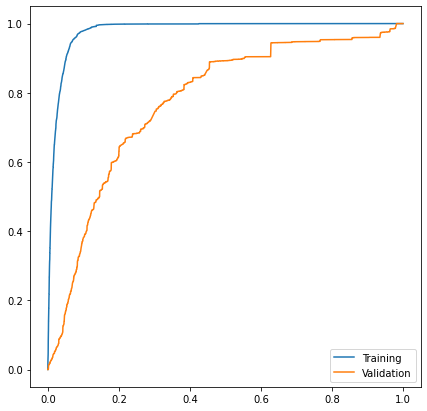

In [22]:
fpr_t_ann, tpr_t_ann, th_t = roc_curve(Y_train.iloc[:,-1], yhat_train_mlp)
fpr_v_ann, tpr_v_ann, th_v = roc_curve(Y_test.iloc[:,-1], yhat_valid_mlp)



plt.plot(fpr_t_ann, tpr_t_ann, label = "Training")
plt.plot(fpr_v_ann, tpr_v_ann, label = "Validation")
plt.legend()

### Linear

In [23]:
inputs = keras.Input(shape=(np.shape(X_train_resampled)[1],), name = 'input')
outputs = tf.keras.layers.Dense(1, activation = 'sigmoid')(inputs)

callback = tf.keras.callbacks.EarlyStopping(monitor = 'loss', patience = 5)

linear = tf.keras.Model(inputs=inputs, outputs=outputs)

linear.compile(optimizer = 'adam',
            loss = 'binary_crossentropy',
            metrics = 'binary_crossentropy'
            )

history_linear = linear.fit(X_train_resampled, y_train_resampled, validation_data=(X_test.iloc[:,3:], Y_test.iloc[:,-1]),  callbacks=[callback] , epochs = 10000, batch_size =  int(len(y_train_resampled)*0.5) )


Epoch 1/10000
2/2 [==============================] - 1s 239ms/step - loss: 1346.6371 - binary_crossentropy: 1346.6371 - val_loss: 3236.4846 - val_binary_crossentropy: 3236.4846
Epoch 2/10000
2/2 [==============================] - 0s 87ms/step - loss: 1315.9324 - binary_crossentropy: 1315.9324 - val_loss: 3171.6697 - val_binary_crossentropy: 3171.6697
Epoch 3/10000
2/2 [==============================] - 0s 91ms/step - loss: 1285.4149 - binary_crossentropy: 1285.4149 - val_loss: 3107.1057 - val_binary_crossentropy: 3107.1057
Epoch 4/10000
2/2 [==============================] - 0s 94ms/step - loss: 1255.1455 - binary_crossentropy: 1255.1455 - val_loss: 3042.8308 - val_binary_crossentropy: 3042.8313
Epoch 5/10000
2/2 [==============================] - 0s 89ms/step - loss: 1225.0155 - binary_crossentropy: 1225.0155 - val_loss: 2978.8813 - val_binary_crossentropy: 2978.8813
Epoch 6/10000
2/2 [==============================] - 0s 83ms/step - loss: 1195.0490 - binary_crossentropy: 1195.0491 - 

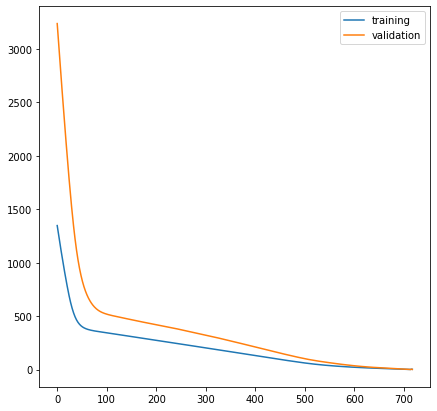

In [24]:
plt.plot(history_linear.history["loss"], label = "training")
plt.plot(history_linear.history["val_loss"], label = "validation")
plt.legend()
plt.show()

In [25]:
yhat_train_linear = linear.predict(np.array(X_train.iloc[:,3:])).flatten()
yhat_valid_linear = linear.predict(np.array(X_test.iloc[:,3:])).flatten()

31313/31313 [==============================] - 26s 823us/step


### Matriz de confusión entrenamiento

In [26]:
pred_round_train_linear=[]
for i in range(len(yhat_train_linear)):
    if yhat_train_linear[i]>=0.5:
        pred_round_train_linear.append(1)
    else:
        pred_round_train_linear.append(0)

In [27]:
cm_train_linear = confusion_matrix(pred_round_train_linear, Y_train.iloc[:,-1])
cm_train_linear

array([[921755,  35227],
       [ 78415,  45437]])

In [28]:
accuracy_score(Y_train.iloc[:,-1], pred_round_train_linear)

0.8948571195946834

In [29]:
matthews_corrcoef(Y_train.iloc[:,-1], pred_round_train_linear)

0.4000484843017638

### Matriz de confusión validación

In [30]:
pred_round_val_linear=[]
for i in range(len(yhat_valid_linear)):
    if yhat_valid_linear[i]>=0.5:
        pred_round_val_linear.append(1)
    else:
        pred_round_val_linear.append(0)

In [31]:
cm = confusion_matrix(pred_round_val_linear, Y_test.iloc[:,-1])
cm

array([[888766,   4116],
       [103376,   5737]])

In [32]:
accuracy_score(Y_test.iloc[:,-1], pred_round_val_linear)

0.892722019570956

In [33]:
matthews_corrcoef(Y_test.iloc[:,-1], pred_round_val_linear)

0.151433627044705

In [34]:
fpr_v_lin, tpr_v_lin, th_val = roc_curve(Y_test.iloc[:,-1], yhat_valid_linear,  drop_intermediate=False)
fpr_t_lin, tpr_t_lin, th_lin = roc_curve(Y_train.iloc[:,-1], yhat_train_linear,  drop_intermediate=False)

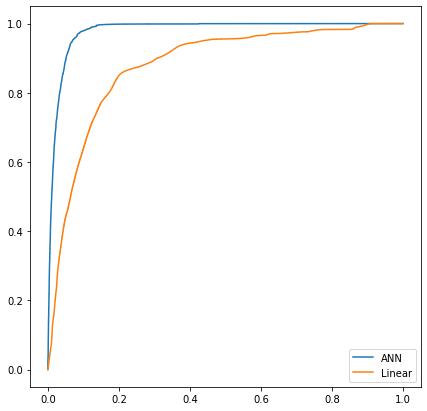

In [35]:
plt.plot(fpr_t_ann, tpr_t_ann, label = "ANN")
plt.plot(fpr_t_lin, tpr_t_lin, label= "Linear")
plt.legend()

In [36]:
fpr_v_lin, tpr_v_lin, th_v_lin = roc_curve(Y_test.iloc[:,-1], yhat_valid_linear)
fpr_v_ann, tpr_v_ann, th_v_mpl = roc_curve(Y_test.iloc[:,-1], yhat_valid_mlp)

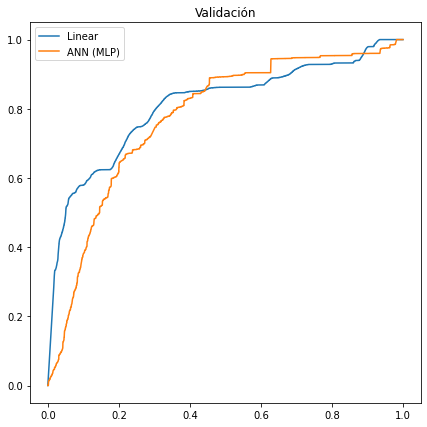

In [37]:
plt.title("Validación")
plt.plot(fpr_v_lin, tpr_v_lin, label = "Linear")
plt.plot(fpr_v_ann, tpr_v_ann, label = "ANN (MLP)")
plt.legend()

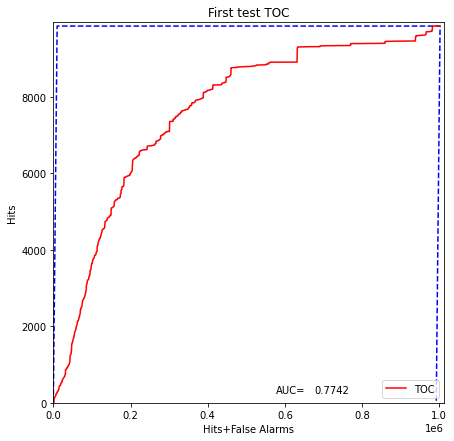

Generating a first random dataset of size 100 with 45 percent of class-1 data. The TOC is stored in the file: TOC-1.png



In [38]:
import toc

rank = yhat_valid_mlp
groundTruth = Y_test.iloc[:,-1]
T1 = toc.compute(rank, groundTruth)
toc.plot(T1, title='First test TOC')
print('Generating a first random dataset of size 100 with 45 percent of class-1 data. The TOC is stored in the file: TOC-1.png\n')

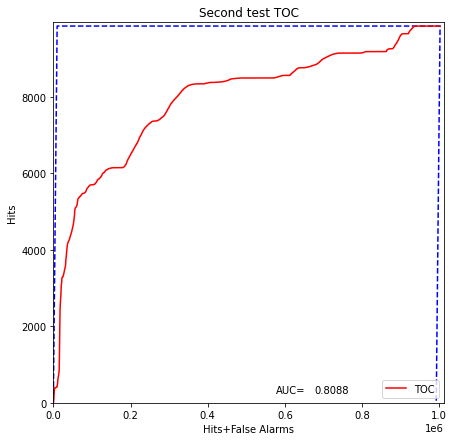

Generating a second random dataset of size 976 with. The TOC is stored in the file: TOC-2.png



In [39]:
rank = yhat_valid_linear

T2 = toc.compute(rank, groundTruth)
toc.plot(T2, title='Second test TOC')
print('Generating a second random dataset of size 976 with. The TOC is stored in the file: TOC-2.png\n')

In [40]:
import importlib
importlib.reload(toc)

<module 'toc' from '/home/jupyter-fnateras2/experimentos/toc.py'>

<Figure size 504x504 with 0 Axes>

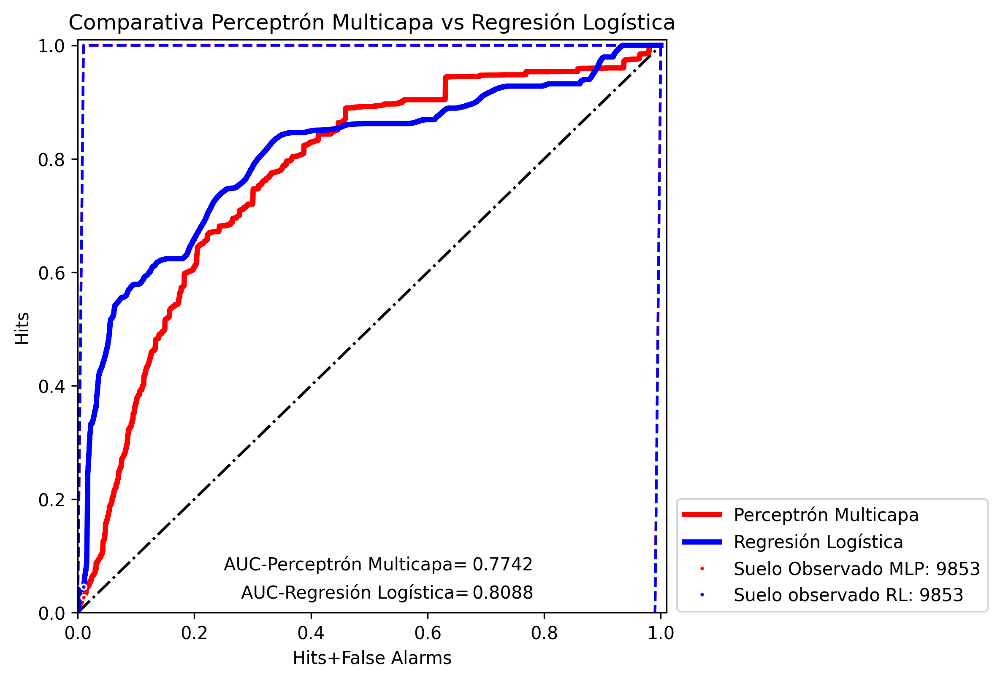

Graphical comparison of the two TOCs with different sizes. The comparison is in comparisonT1T2.png



In [41]:
import toc
toc.plotComp(T1, T2, ne = [9853,9853])
print('Graphical comparison of the two TOCs with different sizes. The comparison is in comparisonT1T2.png\n',)

In [43]:
plt.savefig()

TypeError: savefig() missing 1 required positional argument: 'fname'

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

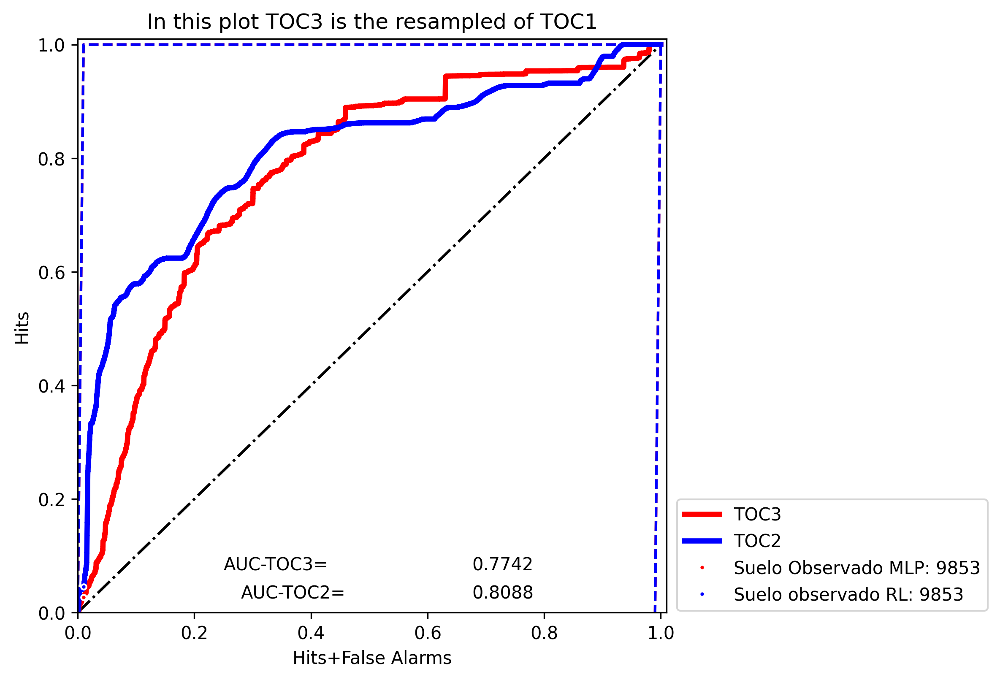

In [42]:
toc.plotComp(T1,T2,TOCname1='TOC3',TOCname2='TOC2',title='In this plot TOC3 is the resampled of TOC1', ne = [9853,9853])

In [44]:
T1

{'ndata': 1001995,
 'type': 'TOC',
 'npos': 9853,
 'TP+FP': array([      0,       1,       2, ..., 1001993, 1001994, 1001995]),
 'TP': array([   0,    1,    2, ..., 9853, 9853, 9853]),
 'thresholds': array([9.9878776e-01, 9.9878675e-01, 9.9877143e-01, ..., 1.3005514e-04,
        1.3005489e-04, 1.3005291e-04], dtype=float32),
 'areaRatio': 0.8186601100036393}

In [45]:
T2

{'ndata': 1001995,
 'type': 'TOC',
 'npos': 9853,
 'TP+FP': array([      0,       1,       2, ..., 1001993, 1001994, 1001995]),
 'TP': array([   0,    0,    0, ..., 9853, 9853, 9853]),
 'thresholds': array([1.00000094e+00, 9.99999940e-01, 9.99999940e-01, ...,
        4.48555191e-16, 4.30029019e-16, 4.22618169e-16]),
 'areaRatio': 0.8059023565832499}

## Predicción con modelos.

In [43]:
header2 = ["Lat","Lon","Urbano", "Cuerpos_agua", "Cultivo_riego","Cultivo_temporal","Past_Mat","Suelo_desnudo",
         "Vegetacion","dist_urbano","dist_agua","dist_riego","dist_temporal","dist_pastizal",
          "dist_suelo_d","dist_vegetacion","dist_anps","dist_vial","dist_centro","coste","pendiente","cve_mun","diferencia"]
header = ["Lat","Lon","Urbano", "Cuerpos_agua", "Cultivo_riego","Cultivo_temporal","Past_Mat","Suelo_desnudo",
         "Vegetacion","dist_urbano","dist_agua","dist_riego","dist_temporal","dist_pastizal",
          "dist_suelo_d","dist_vegetacion","dist_anps","dist_vial","dist_centro","coste","pendiente","diferencia","cve_mun"]

In [44]:
data2018 = pd.read_csv("/home/jupyter-fnateras2/data_morelia_implan/morelia_2018.csv",names=header2)

In [45]:
data2000 = pd.read_csv("/home/jupyter-fnateras2/data_morelia_implan/morelia_2000.csv",names=header)
data2000

,Lat,Lon,Urbano,Cuerpos_agua,Cultivo_riego,Cultivo_temporal,Past_Mat,Suelo_desnudo,Vegetacion,dist_urbano,...,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia,cve_mun
0,288765.542809,2.209592e+06,0,0,0,0,0,0,1,7745.535860,...,7165.029594,9220.253826,0.000000,9402.009689,7971.000019,34868.617939,130.207927,0.200087,0,1
1,288735.545939,2.209562e+06,0,0,0,0,0,0,1,7709.773323,...,7126.103912,9212.430322,0.000000,9365.652316,7934.098791,34827.239272,129.996923,0.178211,0,1
2,288765.542809,2.209562e+06,0,0,0,0,0,0,1,7716.248043,...,7137.143974,9195.468318,0.000000,9372.903230,7942.090226,34843.241277,129.847833,0.199619,0,1
3,288795.539680,2.209562e+06,0,0,0,0,0,0,1,7722.833848,...,7148.292864,9178.573003,0.000000,9380.244465,7950.186809,34859.261749,129.698744,0.219703,0,1
4,288735.545939,2.209532e+06,0,0,0,0,0,0,1,7680.466351,...,7098.192204,9187.721697,0.000000,9336.528939,7905.167932,34801.858306,129.636829,0.177097,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2146195,270977.398588,2.151833e+06,0,0,0,0,1,0,0,15856.470764,...,0.000000,31187.696066,2430.565918,7329.607115,5836.876683,28276.030304,111.421604,5.950574,0,3
2146196,271007.395459,2.151833e+06,0,0,0,0,1,0,0,15874.987952,...,0.000000,31204.295694,2430.380807,7326.598778,5847.119329,28276.905407,111.570693,3.456909,0,3
2146197,270947.401717,2.151803e+06,0,0,0,0,1,0,0,15861.646267,...,0.000000,31196.132621,2461.116840,7362.572123,5855.054017,28305.180293,111.632609,7.099447,0,3
2146198,270977.398588,2.151803e+06,0,0,0,0,1,0,0,15880.100758,...,0.000000,31212.698934,2460.568362,7359.454996,5865.111503,28306.022707,111.781698,6.187764,0,3


In [46]:
data2018

,Lat,Lon,Urbano,Cuerpos_agua,Cultivo_riego,Cultivo_temporal,Past_Mat,Suelo_desnudo,Vegetacion,dist_urbano,...,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,cve_mun,diferencia
0,260628.478257,2.197830e+06,0,1,0,0,0,0,0,3275.311829,...,228.458615,18512.824271,899.990695,18098.051291,1332.196444,20135.641180,41.290986,2.229709,3,0
1,260658.475127,2.197830e+06,0,1,0,0,0,0,0,3288.061757,...,201.235632,18530.143783,924.161269,18076.485369,1307.998737,20121.447884,40.930986,2.286674,3,0
2,260688.471998,2.197830e+06,0,1,0,0,0,0,0,3301.035032,...,174.922397,18547.495636,948.664575,18054.943526,1284.045814,20107.289320,40.570986,2.262799,3,0
3,260598.481386,2.197800e+06,0,1,0,0,0,0,0,3235.495185,...,241.858044,18471.012747,858.010608,18098.835908,1339.596682,20123.468711,41.377606,2.590537,3,0
4,260628.478257,2.197800e+06,0,1,0,0,0,0,0,3248.124382,...,216.327886,18488.322758,882.311384,18077.221147,1314.850934,20109.222078,41.040657,2.511245,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1326016,270977.398588,2.151833e+06,0,0,0,0,1,0,0,14742.199580,...,0.000000,31073.086501,2430.565918,7329.607115,29.996871,28276.030304,96.203015,5.950574,3,0
1326017,271007.395459,2.151833e+06,0,0,0,0,1,0,0,14743.328712,...,0.000000,31089.457897,2430.380807,7326.598778,0.000000,28276.905407,96.129337,3.456909,3,0
1326018,270947.401717,2.151803e+06,0,0,0,0,1,0,0,14771.118181,...,0.000000,31081.901593,2461.116840,7362.572123,59.993741,28305.180293,96.414020,7.099447,3,0
1326019,270977.398588,2.151803e+06,0,0,0,0,1,0,0,14772.184190,...,0.000000,31098.239414,2460.568362,7359.454996,29.996871,28306.022707,96.376848,6.187764,3,0


In [47]:
data_urb_2018=data2018[(data2018["Urbano"]==0) & (data2018["Cuerpos_agua"]==0)]
data_urb_2000=data2000[(data2000["Urbano"]==0) & (data2000["Cuerpos_agua"]==0)]

In [48]:
data_urb_2000=data_urb_2000[data_urb_2000['dist_anps']>0.000000]
data_urb_2000

,Lat,Lon,Urbano,Cuerpos_agua,Cultivo_riego,Cultivo_temporal,Past_Mat,Suelo_desnudo,Vegetacion,dist_urbano,...,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia,cve_mun
0,288765.542809,2.209592e+06,0,0,0,0,0,0,1,7745.535860,...,7165.029594,9220.253826,0.000000,9402.009689,7971.000019,34868.617939,130.207927,0.200087,0,1
1,288735.545939,2.209562e+06,0,0,0,0,0,0,1,7709.773323,...,7126.103912,9212.430322,0.000000,9365.652316,7934.098791,34827.239272,129.996923,0.178211,0,1
2,288765.542809,2.209562e+06,0,0,0,0,0,0,1,7716.248043,...,7137.143974,9195.468318,0.000000,9372.903230,7942.090226,34843.241277,129.847833,0.199619,0,1
3,288795.539680,2.209562e+06,0,0,0,0,0,0,1,7722.833848,...,7148.292864,9178.573003,0.000000,9380.244465,7950.186809,34859.261749,129.698744,0.219703,0,1
4,288735.545939,2.209532e+06,0,0,0,0,0,0,1,7680.466351,...,7098.192204,9187.721697,0.000000,9336.528939,7905.167932,34801.858306,129.636829,0.177097,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2146195,270977.398588,2.151833e+06,0,0,0,0,1,0,0,15856.470764,...,0.000000,31187.696066,2430.565918,7329.607115,5836.876683,28276.030304,111.421604,5.950574,0,3
2146196,271007.395459,2.151833e+06,0,0,0,0,1,0,0,15874.987952,...,0.000000,31204.295694,2430.380807,7326.598778,5847.119329,28276.905407,111.570693,3.456909,0,3
2146197,270947.401717,2.151803e+06,0,0,0,0,1,0,0,15861.646267,...,0.000000,31196.132621,2461.116840,7362.572123,5855.054017,28305.180293,111.632609,7.099447,0,3
2146198,270977.398588,2.151803e+06,0,0,0,0,1,0,0,15880.100758,...,0.000000,31212.698934,2460.568362,7359.454996,5865.111503,28306.022707,111.781698,6.187764,0,3


In [49]:
data_urb_2018=data_urb_2018[data_urb_2018['dist_anps']>0.000000]
data_urb_2018

,Lat,Lon,Urbano,Cuerpos_agua,Cultivo_riego,Cultivo_temporal,Past_Mat,Suelo_desnudo,Vegetacion,dist_urbano,...,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,cve_mun,diferencia
9,261048.434444,2.197800e+06,0,0,0,0,1,0,0,3447.554694,...,0.0,18734.027064,1248.803589,17777.169888,997.266806,19913.443890,36.982928,6.007658,3,0
20,260868.453221,2.197770e+06,0,0,0,0,1,0,0,3330.856765,...,0.0,18603.661290,1073.256704,17884.168435,1106.352244,19969.945500,38.424676,1.801837,3,0
21,260898.450092,2.197770e+06,0,0,0,0,1,0,0,3345.547238,...,0.0,18621.282891,1100.167146,17862.747280,1083.755330,19955.995077,38.087727,2.089429,3,0
22,260928.446962,2.197770e+06,0,0,0,0,1,0,0,3360.441263,...,0.0,18638.936109,1127.233414,17841.350841,1061.525113,19942.080016,37.828873,2.366984,3,0
23,260958.443833,2.197770e+06,0,0,0,0,1,0,0,3375.536145,...,0.0,18656.620853,1154.444548,17819.979204,1039.685116,19928.200391,37.468873,2.648589,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1326016,270977.398588,2.151833e+06,0,0,0,0,1,0,0,14742.199580,...,0.0,31073.086501,2430.565918,7329.607115,29.996871,28276.030304,96.203015,5.950574,3,0
1326017,271007.395459,2.151833e+06,0,0,0,0,1,0,0,14743.328712,...,0.0,31089.457897,2430.380807,7326.598778,0.000000,28276.905407,96.129337,3.456909,3,0
1326018,270947.401717,2.151803e+06,0,0,0,0,1,0,0,14771.118181,...,0.0,31081.901593,2461.116840,7362.572123,59.993741,28305.180293,96.414020,7.099447,3,0
1326019,270977.398588,2.151803e+06,0,0,0,0,1,0,0,14772.184190,...,0.0,31098.239414,2460.568362,7359.454996,29.996871,28306.022707,96.376848,6.187764,3,0


In [50]:
data_urb_2018=data_urb_2018[data_urb_2018["cve_mun"]==3]
data_urb_2000=data_urb_2000[data_urb_2000["cve_mun"]==3]

In [51]:
data_urb_2018.drop(['Lat','Lon','Cuerpos_agua','Cultivo_riego','Cultivo_temporal','Past_Mat','Suelo_desnudo','Vegetacion',
         'Urbano','cve_mun'], axis = 1,inplace=True)

/tmp/ipykernel_64531/2580231214.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_urb_2018.drop(['Lat','Lon','Cuerpos_agua','Cultivo_riego','Cultivo_temporal','Past_Mat','Suelo_desnudo','Vegetacion',


In [52]:
data_urb_2000.drop(['Lat','Lon','Cuerpos_agua','Cultivo_riego','Cultivo_temporal','Past_Mat','Suelo_desnudo','Vegetacion',
         'Urbano','cve_mun'], axis = 1,inplace=True)

/tmp/ipykernel_64531/252830810.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_urb_2000.drop(['Lat','Lon','Cuerpos_agua','Cultivo_riego','Cultivo_temporal','Past_Mat','Suelo_desnudo','Vegetacion',


In [53]:
data_urb_2018

,dist_urbano,dist_agua,dist_riego,dist_temporal,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia
9,3447.554694,212.111013,7573.459735,660.682246,0.0,18734.027064,1248.803589,17777.169888,997.266806,19913.443890,36.982928,6.007658,0
20,3330.856765,29.996871,7622.297672,509.130224,0.0,18603.661290,1073.256704,17884.168435,1106.352244,19969.945500,38.424676,1.801837,0
21,3345.547238,59.993741,7609.360217,530.762556,0.0,18621.282891,1100.167146,17862.747280,1083.755330,19955.995077,38.087727,2.089429,0
22,3360.441263,89.990612,7596.519181,551.557743,0.0,18638.936109,1127.233414,17841.350841,1061.525113,19942.080016,37.828873,2.366984,0
23,3375.536145,119.987482,7583.775051,573.158682,0.0,18656.620853,1154.444548,17819.979204,1039.685116,19928.200391,37.468873,2.648589,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1326016,14742.199580,7484.535890,7133.240185,5206.715727,0.0,31073.086501,2430.565918,7329.607115,29.996871,28276.030304,96.203015,5.950574,0
1326017,14743.328712,7502.007921,7138.599273,5220.609010,0.0,31089.457897,2430.380807,7326.598778,0.000000,28276.905407,96.129337,3.456909,0
1326018,14771.118181,7491.638443,7157.559879,5219.674864,0.0,31081.901593,2461.116840,7362.572123,59.993741,28305.180293,96.414020,7.099447,0
1326019,14772.184190,7508.974118,7162.775149,5233.361810,0.0,31098.239414,2460.568362,7359.454996,29.996871,28306.022707,96.376848,6.187764,0


In [54]:
data_urb_2000

,dist_urbano,dist_agua,dist_riego,dist_temporal,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia
134250,3447.554694,212.111013,7573.459735,660.682246,0.0,18734.027064,1248.803589,17777.169888,3636.319906,19913.443890,73.837972,6.007658,0
135066,3330.856765,29.996871,7622.297672,509.130224,0.0,18603.661290,1073.256704,17884.168435,3530.974224,19969.945500,72.583342,1.801837,0
135067,3345.547238,59.993741,7609.360217,530.762556,0.0,18621.282891,1100.167146,17862.747280,3543.566054,19955.995077,72.732431,2.089429,0
135068,3360.441263,89.990612,7596.519181,551.557743,0.0,18638.936109,1127.233414,17841.350841,3556.366322,19942.080016,72.881521,2.366984,0
135069,3375.536145,119.987482,7583.775051,573.158682,0.0,18656.620853,1154.444548,17819.979204,3569.372785,19928.200391,73.030610,2.648589,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2146195,15856.470764,7484.535890,13541.255423,5206.715727,0.0,31187.696066,2430.565918,7329.607115,5836.876683,28276.030304,111.421604,5.950574,0
2146196,15874.987952,7502.007921,13553.377066,5220.609010,0.0,31204.295694,2430.380807,7326.598778,5847.119329,28276.905407,111.570693,3.456909,0
2146197,15861.646267,7491.638443,13556.677317,5219.674864,0.0,31196.132621,2461.116840,7362.572123,5855.054017,28305.180293,111.632609,7.099447,0
2146198,15880.100758,7508.974118,13568.718868,5233.361810,0.0,31212.698934,2460.568362,7359.454996,5865.111503,28306.022707,111.781698,6.187764,0


In [55]:
copy_2018 = data_urb_2018.copy()
copy_2000 = data_urb_2000.copy()

In [56]:
copy_2018 = copy_2018.sample(frac = 1)
copy_2000 = copy_2000.sample(frac = 1)

In [57]:
copy_2018

,dist_urbano,dist_agua,dist_riego,dist_temporal,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia
588507,241.890097,8701.828718,1439.849785,1332.196444,0.000000,3454.158548,108.163943,13069.894719,108.163943,21580.487884,29.439389,3.554305,0
675692,593.985262,11155.853912,4494.262449,711.267663,0.000000,2486.409381,390.061117,9893.995991,617.796589,19325.757665,30.400896,3.803085,0
76251,1449.182780,3920.820030,13167.203280,573.158682,318.907207,8492.178178,0.000000,20828.276434,371.046495,24382.275646,43.714604,7.608263,0
860869,1386.828725,5160.931892,5207.535439,1398.371994,807.704710,6338.296608,0.000000,4918.191195,1741.574549,16547.239190,38.786564,11.816289,0
945538,4951.333370,8282.615248,5939.852617,593.985262,365.020371,8360.978035,0.000000,9280.978939,1783.794839,21017.229942,54.498063,20.526089,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027210,695.950819,3985.261951,1082.104149,0.000000,342.100050,10852.468185,2072.107856,6647.610019,169.710075,18504.162739,22.622583,1.903520,0
5881,1328.639749,3737.520954,9258.088478,2118.427874,0.000000,14923.355806,94.880721,20578.856100,119.987482,21369.985368,34.092686,1.778744,0
356459,174.943884,13439.305540,3072.363874,1492.315066,0.000000,14060.226615,997.145949,6418.340444,0.000000,4718.279843,8.232598,1.640084,0
405870,2403.642829,11983.811176,4670.983899,127.282556,29.996871,7067.973695,0.000000,7309.866878,1922.218178,10651.383289,39.880273,5.077828,0


In [58]:
copy_2000

,dist_urbano,dist_agua,dist_riego,dist_temporal,dist_pastizal,dist_suelo_d,dist_vegetacion,dist_anps,dist_vial,dist_centro,coste,pendiente,diferencia
851591,3329.652628,7149.336775,22206.961764,3203.651188,458.868492,8771.540296,0.000000,23257.743633,3577.689087,30312.783287,86.558601,4.001960,0
227827,256.352033,2439.669020,9296.620179,1012.174890,0.000000,13627.071199,666.098222,20600.044847,67.078544,21112.507422,31.111836,4.399860,0
1777087,5627.670240,10411.539721,4760.992984,618.410825,0.000000,10256.640927,1897.603898,11756.147808,3490.999964,23532.211422,71.589261,2.814594,0
1506539,1539.504596,3588.160652,3273.098882,664.165045,0.000000,6599.188876,1394.489144,2339.755901,1135.814325,13813.871126,30.918914,6.967325,0
1831873,6784.129904,5523.645007,3443.114978,825.345943,4858.451258,18066.374938,0.000000,2779.077905,1309.636534,13392.974630,36.776053,7.873203,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,2068.133447,8633.411001,14452.964514,0.000000,389.959317,4057.664952,313.251529,14867.748372,1780.847965,23419.592719,50.130453,7.264126,0
965896,2630.837221,7876.426086,20277.801693,979.441457,2757.788715,7169.817123,0.000000,21107.745285,2117.608814,28687.538830,76.056730,4.697014,0
1029173,1082.104149,9213.859133,2666.295670,1046.514110,0.000000,7380.282336,1994.555756,5299.201355,785.190181,9169.456743,23.666797,11.183188,0
1867792,5718.218294,5461.691083,2101.109612,1132.172146,5367.359323,17788.565324,0.000000,3191.925571,2619.529941,14413.858626,53.553187,6.323434,0


## Predicciones (MLP & Linear) sobre el dataset

In [59]:
cols = copy_2018.columns.tolist()
cols

['dist_urbano',
 'dist_agua',
 'dist_riego',
 'dist_temporal',
 'dist_pastizal',
 'dist_suelo_d',
 'dist_vegetacion',
 'dist_anps',
 'dist_vial',
 'dist_centro',
 'coste',
 'pendiente',
 'diferencia']

In [60]:
cols=['pendiente','dist_anps','dist_agua','dist_vegetacion','dist_urbano','dist_centro','dist_vial','coste','diferencia']

In [61]:
copy_2018 = copy_2018[cols]
copy_2000 = copy_2000[cols]

In [62]:
predicciones_mlp=MLP.predict(copy_2018.iloc[:,:-1])
predicciones_mlp_train=MLP.predict(copy_2000.iloc[:,:-1])

33804/33804 [==============================] - 36s 1ms/step


In [63]:
predicciones_linear=linear.predict(copy_2018.iloc[:,:-1])
predicciones_linear_train=linear.predict(copy_2000.iloc[:,:-1])

33804/33804 [==============================] - 30s 894us/step


In [64]:
pred_round2018_mlp=[]
for i in range(1001994):
    if predicciones_mlp[i]>=0.5:
        pred_round2018_mlp.append(1)
    else:
        pred_round2018_mlp.append(0)

In [65]:
pred_round2018_linear=[]
for i in range(1001994):
    if predicciones_linear[i]>=0.5:
        pred_round2018_linear.append(1)
    else:
        pred_round2018_linear.append(0)

In [66]:
pred_round2000_mlp=[]
for i in range(1081728):
    if predicciones_mlp_train[i]>=0.5:
        pred_round2000_mlp.append(1)
    else:
        pred_round2000_mlp.append(0)

In [67]:
pred_round2000_linear=[]
for i in range(1081728):
    if predicciones_linear_train[i]>=0.5:
        pred_round2000_linear.append(1)
    else:
        pred_round2000_linear.append(0)

Asignación de las predicciones a su respectiva observación

In [68]:
copy_2018 = copy_2018.reindex(columns = copy_2018.columns.tolist() + ["Proba_1_mlp","Pred_mlp","Proba_1_lin","Pred_lin","True"])

copy_2018

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True
588507,3.554305,13069.894719,8701.828718,108.163943,241.890097,21580.487884,108.163943,29.439389,0,NaN,NaN,NaN,NaN,NaN
675692,3.803085,9893.995991,11155.853912,390.061117,593.985262,19325.757665,617.796589,30.400896,0,NaN,NaN,NaN,NaN,NaN
76251,7.608263,20828.276434,3920.820030,0.000000,1449.182780,24382.275646,371.046495,43.714604,0,NaN,NaN,NaN,NaN,NaN
860869,11.816289,4918.191195,5160.931892,0.000000,1386.828725,16547.239190,1741.574549,38.786564,0,NaN,NaN,NaN,NaN,NaN
945538,20.526089,9280.978939,8282.615248,0.000000,4951.333370,21017.229942,1783.794839,54.498063,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027210,1.903520,6647.610019,3985.261951,2072.107856,695.950819,18504.162739,169.710075,22.622583,0,NaN,NaN,NaN,NaN,NaN
5881,1.778744,20578.856100,3737.520954,94.880721,1328.639749,21369.985368,119.987482,34.092686,0,NaN,NaN,NaN,NaN,NaN
356459,1.640084,6418.340444,13439.305540,997.145949,174.943884,4718.279843,0.000000,8.232598,0,NaN,NaN,NaN,NaN,NaN
405870,5.077828,7309.866878,11983.811176,0.000000,2403.642829,10651.383289,1922.218178,39.880273,0,NaN,NaN,NaN,NaN,NaN


In [69]:
copy_2000 = copy_2000.reindex(columns = copy_2000.columns.tolist() + ["Proba_1_mlp","Pred_mlp","Proba_1_lin","Pred_lin","True"])

copy_2000

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True
851591,4.001960,23257.743633,7149.336775,0.000000,3329.652628,30312.783287,3577.689087,86.558601,0,NaN,NaN,NaN,NaN,NaN
227827,4.399860,20600.044847,2439.669020,666.098222,256.352033,21112.507422,67.078544,31.111836,0,NaN,NaN,NaN,NaN,NaN
1777087,2.814594,11756.147808,10411.539721,1897.603898,5627.670240,23532.211422,3490.999964,71.589261,0,NaN,NaN,NaN,NaN,NaN
1506539,6.967325,2339.755901,3588.160652,1394.489144,1539.504596,13813.871126,1135.814325,30.918914,0,NaN,NaN,NaN,NaN,NaN
1831873,7.873203,2779.077905,5523.645007,0.000000,6784.129904,13392.974630,1309.636534,36.776053,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,7.264126,14867.748372,8633.411001,313.251529,2068.133447,23419.592719,1780.847965,50.130453,0,NaN,NaN,NaN,NaN,NaN
965896,4.697014,21107.745285,7876.426086,0.000000,2630.837221,28687.538830,2117.608814,76.056730,0,NaN,NaN,NaN,NaN,NaN
1029173,11.183188,5299.201355,9213.859133,1994.555756,1082.104149,9169.456743,785.190181,23.666797,0,NaN,NaN,NaN,NaN,NaN
1867792,6.323434,3191.925571,5461.691083,0.000000,5718.218294,14413.858626,2619.529941,53.553187,0,NaN,NaN,NaN,NaN,NaN


In [70]:
###########val############
for i in range(1001994):
    copy_2018.at[copy_2018.index[i],'Proba_1_mlp']=predicciones_mlp[i]
    copy_2018.at[copy_2018.index[i],'Pred_mlp']=pred_round2018_mlp[i]
    
    copy_2018.at[copy_2018.index[i],'Proba_1_lin']=predicciones_linear[i]
    copy_2018.at[copy_2018.index[i],'Pred_lin']=pred_round2018_linear[i]

In [71]:
################train######################
for i in range(1081728):
    copy_2000.at[copy_2000.index[i],'Proba_1_mlp']=predicciones_mlp_train[i]
    copy_2000.at[copy_2000.index[i],'Pred_mlp']=pred_round2000_mlp[i]
    
    copy_2000.at[copy_2000.index[i],'Proba_1_lin']=predicciones_linear_train[i]
    copy_2000.at[copy_2000.index[i],'Pred_lin']=pred_round2000_linear[i]

In [72]:
copy_2018

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True
588507,3.554305,13069.894719,8701.828718,108.163943,241.890097,21580.487884,108.163943,29.439389,0,0.133266,0.0,2.108121e-07,0.0,NaN
675692,3.803085,9893.995991,11155.853912,390.061117,593.985262,19325.757665,617.796589,30.400896,0,0.519827,1.0,1.873430e-03,0.0,NaN
76251,7.608263,20828.276434,3920.820030,0.000000,1449.182780,24382.275646,371.046495,43.714604,0,0.003219,0.0,1.071689e-17,0.0,NaN
860869,11.816289,4918.191195,5160.931892,0.000000,1386.828725,16547.239190,1741.574549,38.786564,0,0.000396,0.0,1.414209e-06,0.0,NaN
945538,20.526089,9280.978939,8282.615248,0.000000,4951.333370,21017.229942,1783.794839,54.498063,0,0.002794,0.0,2.058534e-12,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027210,1.903520,6647.610019,3985.261951,2072.107856,695.950819,18504.162739,169.710075,22.622583,0,0.004329,0.0,9.426780e-05,0.0,NaN
5881,1.778744,20578.856100,3737.520954,94.880721,1328.639749,21369.985368,119.987482,34.092686,0,0.689250,1.0,6.960198e-16,0.0,NaN
356459,1.640084,6418.340444,13439.305540,997.145949,174.943884,4718.279843,0.000000,8.232598,0,0.994433,1.0,9.999998e-01,1.0,NaN
405870,5.077828,7309.866878,11983.811176,0.000000,2403.642829,10651.383289,1922.218178,39.880273,0,0.005532,0.0,2.383325e-02,0.0,NaN


In [73]:
copy_2000

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True
851591,4.001960,23257.743633,7149.336775,0.000000,3329.652628,30312.783287,3577.689087,86.558601,0,0.000151,0.0,8.365876e-22,0.0,NaN
227827,4.399860,20600.044847,2439.669020,666.098222,256.352033,21112.507422,67.078544,31.111836,0,0.804403,1.0,9.193443e-15,0.0,NaN
1777087,2.814594,11756.147808,10411.539721,1897.603898,5627.670240,23532.211422,3490.999964,71.589261,0,0.000239,0.0,2.738829e-11,0.0,NaN
1506539,6.967325,2339.755901,3588.160652,1394.489144,1539.504596,13813.871126,1135.814325,30.918914,0,0.004710,0.0,3.668016e-04,0.0,NaN
1831873,7.873203,2779.077905,5523.645007,0.000000,6784.129904,13392.974630,1309.636534,36.776053,0,0.000207,0.0,3.959238e-10,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,7.264126,14867.748372,8633.411001,313.251529,2068.133447,23419.592719,1780.847965,50.130453,0,0.001487,0.0,3.371343e-11,0.0,NaN
965896,4.697014,21107.745285,7876.426086,0.000000,2630.837221,28687.538830,2117.608814,76.056730,0,0.000341,0.0,2.069826e-19,0.0,NaN
1029173,11.183188,5299.201355,9213.859133,1994.555756,1082.104149,9169.456743,785.190181,23.666797,0,0.590911,1.0,9.927275e-01,1.0,NaN
1867792,6.323434,3191.925571,5461.691083,0.000000,5718.218294,14413.858626,2619.529941,53.553187,0,0.000070,0.0,1.769033e-10,0.0,NaN


Asignación de sus respetvivas coordenadas

In [74]:
copy_2018 = copy_2018.reindex(columns = copy_2018.columns.tolist() + ["Lat", "Lon"])

copy_2018

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon
588507,3.554305,13069.894719,8701.828718,108.163943,241.890097,21580.487884,108.163943,29.439389,0,0.133266,0.0,2.108121e-07,0.0,NaN,NaN,NaN
675692,3.803085,9893.995991,11155.853912,390.061117,593.985262,19325.757665,617.796589,30.400896,0,0.519827,1.0,1.873430e-03,0.0,NaN,NaN,NaN
76251,7.608263,20828.276434,3920.820030,0.000000,1449.182780,24382.275646,371.046495,43.714604,0,0.003219,0.0,1.071689e-17,0.0,NaN,NaN,NaN
860869,11.816289,4918.191195,5160.931892,0.000000,1386.828725,16547.239190,1741.574549,38.786564,0,0.000396,0.0,1.414209e-06,0.0,NaN,NaN,NaN
945538,20.526089,9280.978939,8282.615248,0.000000,4951.333370,21017.229942,1783.794839,54.498063,0,0.002794,0.0,2.058534e-12,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027210,1.903520,6647.610019,3985.261951,2072.107856,695.950819,18504.162739,169.710075,22.622583,0,0.004329,0.0,9.426780e-05,0.0,NaN,NaN,NaN
5881,1.778744,20578.856100,3737.520954,94.880721,1328.639749,21369.985368,119.987482,34.092686,0,0.689250,1.0,6.960198e-16,0.0,NaN,NaN,NaN
356459,1.640084,6418.340444,13439.305540,997.145949,174.943884,4718.279843,0.000000,8.232598,0,0.994433,1.0,9.999998e-01,1.0,NaN,NaN,NaN
405870,5.077828,7309.866878,11983.811176,0.000000,2403.642829,10651.383289,1922.218178,39.880273,0,0.005532,0.0,2.383325e-02,0.0,NaN,NaN,NaN


In [75]:
copy_2000 = copy_2000.reindex(columns = copy_2000.columns.tolist() + ["Lat", "Lon"])

copy_2000

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon
851591,4.001960,23257.743633,7149.336775,0.000000,3329.652628,30312.783287,3577.689087,86.558601,0,0.000151,0.0,8.365876e-22,0.0,NaN,NaN,NaN
227827,4.399860,20600.044847,2439.669020,666.098222,256.352033,21112.507422,67.078544,31.111836,0,0.804403,1.0,9.193443e-15,0.0,NaN,NaN,NaN
1777087,2.814594,11756.147808,10411.539721,1897.603898,5627.670240,23532.211422,3490.999964,71.589261,0,0.000239,0.0,2.738829e-11,0.0,NaN,NaN,NaN
1506539,6.967325,2339.755901,3588.160652,1394.489144,1539.504596,13813.871126,1135.814325,30.918914,0,0.004710,0.0,3.668016e-04,0.0,NaN,NaN,NaN
1831873,7.873203,2779.077905,5523.645007,0.000000,6784.129904,13392.974630,1309.636534,36.776053,0,0.000207,0.0,3.959238e-10,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,7.264126,14867.748372,8633.411001,313.251529,2068.133447,23419.592719,1780.847965,50.130453,0,0.001487,0.0,3.371343e-11,0.0,NaN,NaN,NaN
965896,4.697014,21107.745285,7876.426086,0.000000,2630.837221,28687.538830,2117.608814,76.056730,0,0.000341,0.0,2.069826e-19,0.0,NaN,NaN,NaN
1029173,11.183188,5299.201355,9213.859133,1994.555756,1082.104149,9169.456743,785.190181,23.666797,0,0.590911,1.0,9.927275e-01,1.0,NaN,NaN,NaN
1867792,6.323434,3191.925571,5461.691083,0.000000,5718.218294,14413.858626,2619.529941,53.553187,0,0.000070,0.0,1.769033e-10,0.0,NaN,NaN,NaN


In [76]:
for i in range(1001994):
    copy_2018.at[copy_2018.index[i],'True']=data2018.iloc[copy_2018.index[i],-1]
    copy_2018.at[copy_2018.index[i],'Lat']=data2018.iloc[copy_2018.index[i],0]
    copy_2018.at[copy_2018.index[i],'Lon']=data2018.iloc[copy_2018.index[i],1]

In [77]:
for i in range(1081728):
    copy_2000.at[copy_2000.index[i],'True']=data2000.iloc[copy_2000.index[i],-2]
    copy_2000.at[copy_2000.index[i],'Lat']=data2000.iloc[copy_2000.index[i],0]
    copy_2000.at[copy_2000.index[i],'Lon']=data2000.iloc[copy_2000.index[i],1]

In [78]:
copy_2018

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon
588507,3.554305,13069.894719,8701.828718,108.163943,241.890097,21580.487884,108.163943,29.439389,0,0.133266,0.0,2.108121e-07,0.0,0.0,248659.726918,2.178327e+06
675692,3.803085,9893.995991,11155.853912,390.061117,593.985262,19325.757665,617.796589,30.400896,0,0.519827,1.0,1.873430e-03,0.0,0.0,251239.457783,2.176197e+06
76251,7.608263,20828.276434,3920.820030,0.000000,1449.182780,24382.275646,371.046495,43.714604,0,0.003219,0.0,1.071689e-17,0.0,0.0,248809.711270,2.191859e+06
860869,11.816289,4918.191195,5160.931892,0.000000,1386.828725,16547.239190,1741.574549,38.786564,0,0.000396,0.0,1.414209e-06,0.0,0.0,255858.975844,2.171786e+06
945538,20.526089,9280.978939,8282.615248,0.000000,4951.333370,21017.229942,1783.794839,54.498063,0,0.002794,0.0,2.058534e-12,0.0,0.0,252049.373287,2.169446e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027210,1.903520,6647.610019,3985.261951,2072.107856,695.950819,18504.162739,169.710075,22.622583,0,0.004329,0.0,9.426780e-05,0.0,0.0,256758.881959,2.167346e+06
5881,1.778744,20578.856100,3737.520954,94.880721,1328.639749,21369.985368,119.987482,34.092686,0,0.689250,1.0,6.960198e-16,0.0,0.0,256338.925772,2.196390e+06
356459,1.640084,6418.340444,13439.305540,997.145949,174.943884,4718.279843,0.000000,8.232598,0,0.994433,1.0,9.999998e-01,1.0,0.0,267227.789772,2.183788e+06
405870,5.077828,7309.866878,11983.811176,0.000000,2403.642829,10651.383289,1922.218178,39.880273,0,0.005532,0.0,2.383325e-02,0.0,0.0,259848.559623,2.182738e+06


In [79]:
copy_2000

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon
851591,4.001960,23257.743633,7149.336775,0.000000,3329.652628,30312.783287,3577.689087,86.558601,0,0.000151,0.0,8.365876e-22,0.0,0.0,240110.618818,2.184028e+06
227827,4.399860,20600.044847,2439.669020,666.098222,256.352033,21112.507422,67.078544,31.111836,0,0.804403,1.0,9.193443e-15,0.0,0.0,255559.007138,2.195340e+06
1777087,2.814594,11756.147808,10411.539721,1897.603898,5627.670240,23532.211422,3490.999964,71.589261,0,0.000239,0.0,2.738829e-11,0.0,0.0,249979.589221,2.168006e+06
1506539,6.967325,2339.755901,3588.160652,1394.489144,1539.504596,13813.871126,1135.814325,30.918914,0,0.004710,0.0,3.668016e-04,0.0,0.0,258288.722356,2.173046e+06
1831873,7.873203,2779.077905,5523.645007,0.000000,6784.129904,13392.974630,1309.636534,36.776053,0,0.000207,0.0,3.959238e-10,0.0,0.0,268097.699018,2.166865e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,7.264126,14867.748372,8633.411001,313.251529,2068.133447,23419.592719,1780.847965,50.130453,0,0.001487,0.0,3.371343e-11,0.0,0.0,246799.920945,2.178537e+06
965896,4.697014,21107.745285,7876.426086,0.000000,2630.837221,28687.538830,2117.608814,76.056730,0,0.000341,0.0,2.069826e-19,0.0,0.0,241550.468603,2.182108e+06
1029173,11.183188,5299.201355,9213.859133,1994.555756,1082.104149,9169.456743,785.190181,23.666797,0,0.590911,1.0,9.927275e-01,1.0,0.0,261048.434444,2.181058e+06
1867792,6.323434,3191.925571,5461.691083,0.000000,5718.218294,14413.858626,2619.529941,53.553187,0,0.000070,0.0,1.769033e-10,0.0,0.0,267047.808549,2.166025e+06


Creación del dataset geoespacial

In [80]:
geometry=[Point(xy) for xy in zip(copy_2018["Lat"], copy_2018["Lon"])]

In [81]:
geometry_train=[Point(xy) for xy in zip(copy_2000["Lat"], copy_2000["Lon"])]

Sistema de coordenadas

In [82]:
crs_m={'init':'epsg:32614'}

In [83]:
geodata=gpd.GeoDataFrame(copy_2018,crs=crs_m, geometry=geometry)

/home/jupyter-fnateras2/.local/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [84]:
geodata_train=gpd.GeoDataFrame(copy_2000,crs=crs_m, geometry=geometry_train)

/home/jupyter-fnateras2/.local/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [85]:
geodata_train

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon,geometry
851591,4.001960,23257.743633,7149.336775,0.000000,3329.652628,30312.783287,3577.689087,86.558601,0,0.000151,0.0,8.365876e-22,0.0,0.0,240110.618818,2.184028e+06,POINT (240110.619 2184028.128)
227827,4.399860,20600.044847,2439.669020,666.098222,256.352033,21112.507422,67.078544,31.111836,0,0.804403,1.0,9.193443e-15,0.0,0.0,255559.007138,2.195340e+06,POINT (255559.007 2195339.900)
1777087,2.814594,11756.147808,10411.539721,1897.603898,5627.670240,23532.211422,3490.999964,71.589261,0,0.000239,0.0,2.738829e-11,0.0,0.0,249979.589221,2.168006e+06,POINT (249979.589 2168005.617)
1506539,6.967325,2339.755901,3588.160652,1394.489144,1539.504596,13813.871126,1135.814325,30.918914,0,0.004710,0.0,3.668016e-04,0.0,0.0,258288.722356,2.173046e+06,POINT (258288.722 2173046.407)
1831873,7.873203,2779.077905,5523.645007,0.000000,6784.129904,13392.974630,1309.636534,36.776053,0,0.000207,0.0,3.959238e-10,0.0,0.0,268097.699018,2.166865e+06,POINT (268097.699 2166865.439)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173797,7.264126,14867.748372,8633.411001,313.251529,2068.133447,23419.592719,1780.847965,50.130453,0,0.001487,0.0,3.371343e-11,0.0,0.0,246799.920945,2.178537e+06,POINT (246799.921 2178537.268)
965896,4.697014,21107.745285,7876.426086,0.000000,2630.837221,28687.538830,2117.608814,76.056730,0,0.000341,0.0,2.069826e-19,0.0,0.0,241550.468603,2.182108e+06,POINT (241550.469 2182107.827)
1029173,11.183188,5299.201355,9213.859133,1994.555756,1082.104149,9169.456743,785.190181,23.666797,0,0.590911,1.0,9.927275e-01,1.0,0.0,261048.434444,2.181058e+06,POINT (261048.434 2181057.662)
1867792,6.323434,3191.925571,5461.691083,0.000000,5718.218294,14413.858626,2619.529941,53.553187,0,0.000070,0.0,1.769033e-10,0.0,0.0,267047.808549,2.166025e+06,POINT (267047.809 2166025.307)


Ejemplo mapa

#### Visualización de predicciones MLP

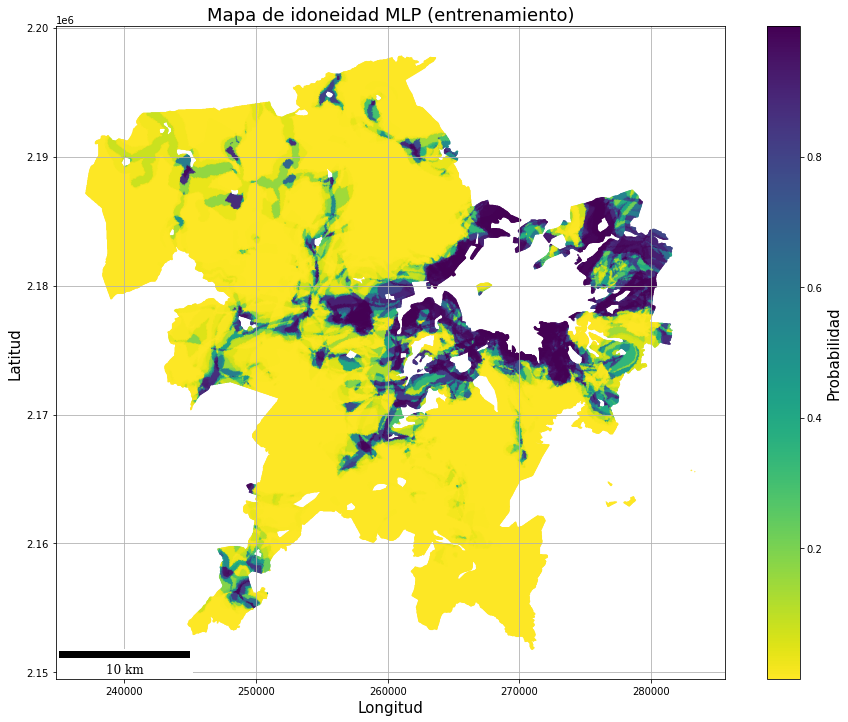

In [86]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(geodata_train['Lat'], geodata_train['Lon'], c=geodata_train['Proba_1_mlp'], cmap='viridis_r',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Probabilidad',fontsize=15)###idoneidad
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de idoneidad MLP (entrenamiento)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

In [103]:
from folium import plugins

In [87]:
sanfran_map = folium.Map(location=[19.70078, -101.18443], tiles="OpenStreetMap", zoom_start=10)

# display the map of San Francisco
sanfran_map

In [88]:
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, in zip(copy_2018["Lat"].iloc[:100], copy_2018["Lon"].iloc[:100]):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=20, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )
# add incidents to map
sanfran_map.add_child(incidents)
sanfran_map

In [89]:
from pyproj import Transformer

from pyproj import Proj

In [90]:
myProj = Proj("+proj=utm +zone=14 +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")

In [91]:
lon1, lat1 = myProj(copy_2018["Lat"].iloc[:100000], copy_2018["Lon"].iloc[:100000], inverse=True)

In [92]:
import branca.colormap as cm

In [93]:
5+5

10

In [94]:
step = cm.StepColormap(
    ["green", "yellow", "red"], vmin=3, vmax=10, index=[3, 4, 8, 10], caption="step"
)

step

In [95]:
colormap=cm.linear.viridis.to_step(5).scale(0, 1)
colormap

In [96]:
m1=folium.Map(location=[19.70078, -101.18443], tiles="OpenStreetMap", zoom_start=10)
#location=location[0:2000]
for lat,lon,val in zip(lat1, lon1,copy_2018["Proba_1_mlp"].iloc[:10000]):
     folium.CircleMarker([lat, lon],
                            radius=6,
                            color=False,
                            fill_color=colormap(val),
                            fill=True,
                            fill_opacity=0.5,
                           ).add_to(m1)

        
m1

In [97]:
tile_url = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'

m1=folium.Map(location=[19.70078, -101.18443], tiles=tile_url, zoom_start=10, attr='Esri',overlay=False, control=True)
#location=location[0:2000]
for lat,lon,val in zip(lat1, lon1,copy_2018["Proba_1_mlp"].iloc[:10000]):
     folium.CircleMarker([lat, lon],
                            radius=2,
                            color=False,
                            fill_color=colormap(val),
                            fill=True,
                            fill_opacity=0.5
                           ).add_to(m1)
        


m1

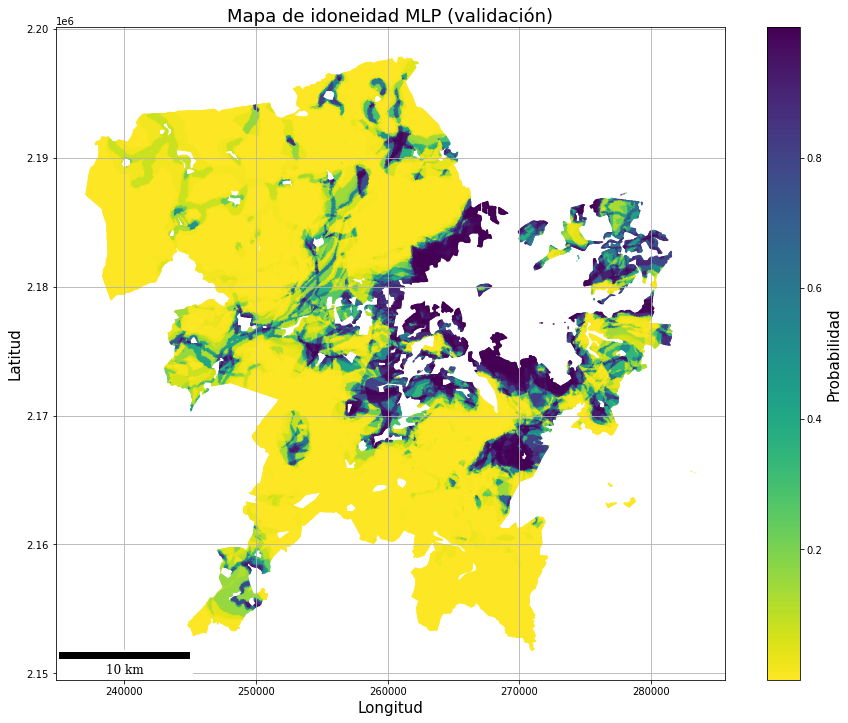

In [98]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(geodata['Lat'], geodata['Lon'], c=geodata['Proba_1_mlp'], cmap='viridis_r',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Probabilidad',fontsize=15)###idoneidad
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de idoneidad MLP (validación)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

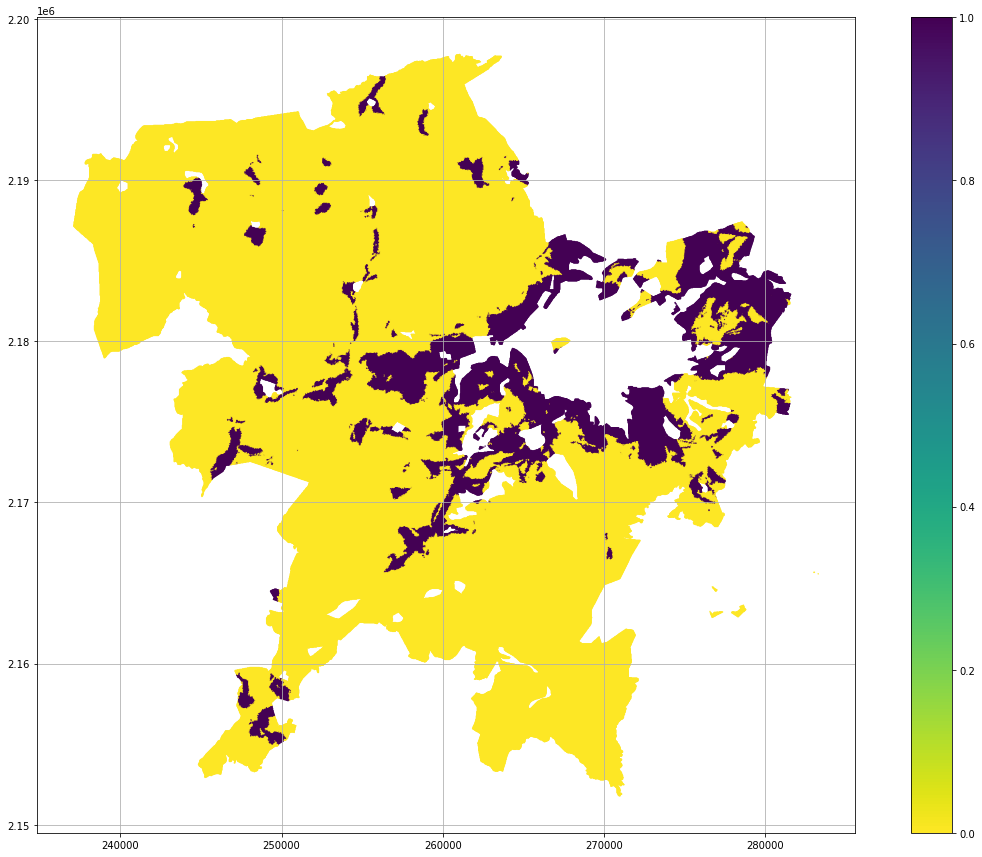

In [99]:
geodata_train.plot(figsize=(20, 15),column=geodata_train['Pred_mlp'], cmap="viridis_r",legend=True,s=0.2)
plt.grid()

In [100]:
geodata = geodata.reindex(columns = geodata.columns.tolist() + ["color"])

In [101]:
geodata_train = geodata_train.reindex(columns = geodata_train.columns.tolist() + ["color"])

In [102]:
geodata.loc[(geodata["True"]==1) & (geodata["Pred_mlp"]==1),"color"]="TP"
geodata.loc[(geodata["True"]==0) & (geodata["Pred_mlp"]==0),"color"]="TN"
geodata.loc[(geodata["True"]==1) & (geodata["Pred_mlp"]==0),"color"]="FN"
geodata.loc[(geodata["True"]==0) & (geodata["Pred_mlp"]==1),"color"]="FP"

In [103]:
geodata_train.loc[(geodata_train["True"]==1) & (geodata_train["Pred_mlp"]==1),"color"]="TP"
geodata_train.loc[(geodata_train["True"]==0) & (geodata_train["Pred_mlp"]==0),"color"]="TN"
geodata_train.loc[(geodata_train["True"]==1) & (geodata_train["Pred_mlp"]==0),"color"]="FN"
geodata_train.loc[(geodata_train["True"]==0) & (geodata_train["Pred_mlp"]==1),"color"]="FP"

In [104]:
pointsPalette = {'TP': 'red',
                 'TN': 'gray', 
                 'FP': 'yellow', 
                 'FN': 'blue' 
                }

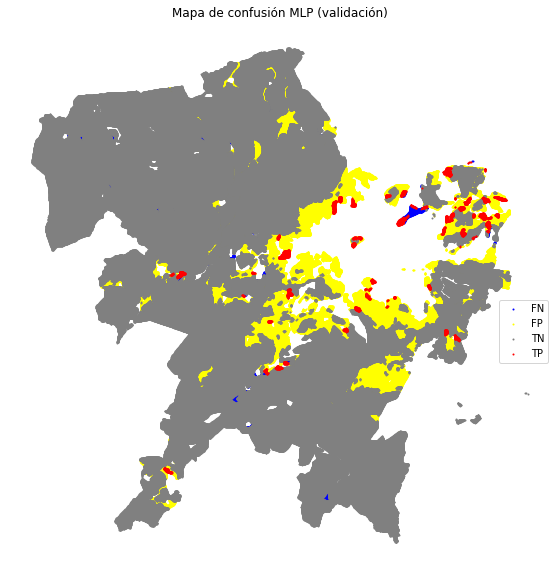

In [105]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in geodata.groupby('color'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión MLP (validación)')

ax.set_axis_off()
plt.show()

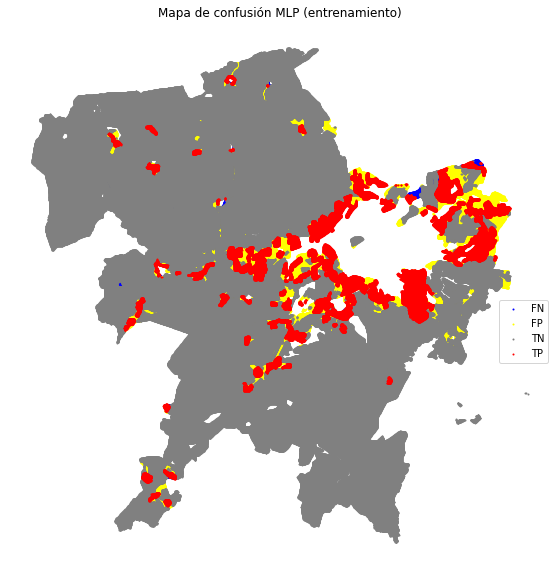

In [106]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in geodata_train.groupby('color'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión MLP (entrenamiento)')

ax.set_axis_off()
plt.show()

In [107]:
geodata["color"].value_counts()

color
TN    840496
FP    151645
TP      5196
FN      4657
Name: count, dtype: int64

In [108]:
geodata_train["color"].value_counts()

color
TN    915921
FP     85140
TP     76039
FN      4628
Name: count, dtype: int64

In [109]:
geodata["color"].value_counts().sum()

1001994

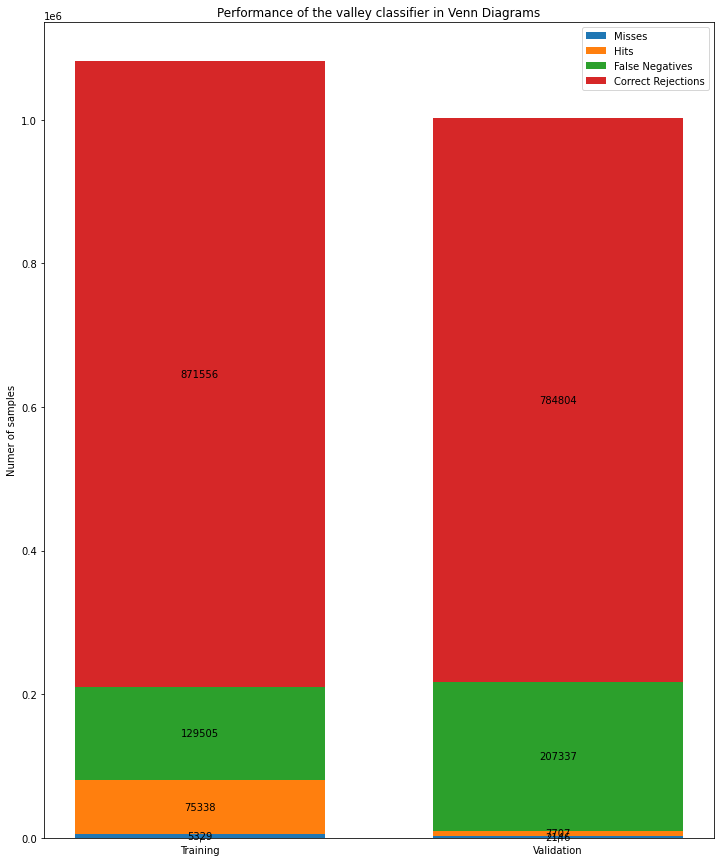

In [110]:
sets = (
    "Training",
    "Validation"
)
weight_counts = {
    "Misses": np.array([5329, 2146]),
    "Hits": np.array([75338, 7707]),
    "False Negatives": np.array([129505, 207337]),
    "Correct Rejections": np.array([871556, 784804]),
}
width = 0.7

fig, ax = plt.subplots(figsize=(12, 15))
bottom = np.zeros(2)

for metric, weight_count in weight_counts.items():
    p = ax.bar(sets, weight_count, width, label=metric, bottom=bottom)
    bottom += weight_count
    ax.bar_label(p, label_type='center')

ax.set_title("Performance of the valley classifier in Venn Diagrams")
ax.set_ylabel("Numer of samples")
ax.legend(loc="upper right")

In [111]:
geodata_train["color"].value_counts()

color
TN    915921
FP     85140
TP     76039
FN      4628
Name: count, dtype: int64

#### Visualización de predicciones Linear

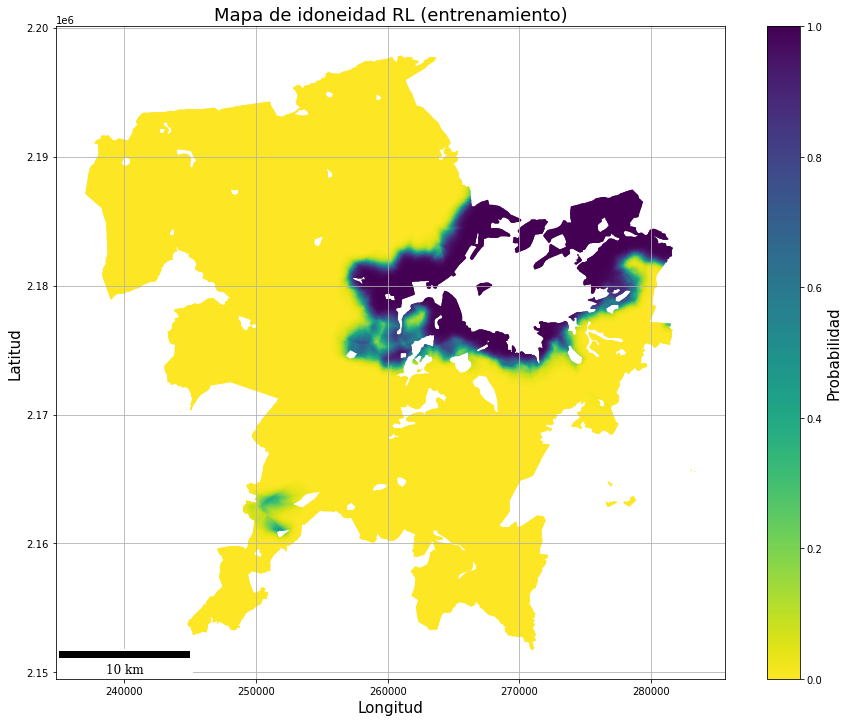

In [112]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(geodata_train['Lat'], geodata_train['Lon'], c=geodata_train['Proba_1_lin'], cmap='viridis_r',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Probabilidad',fontsize=15)
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de idoneidad RL (entrenamiento)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

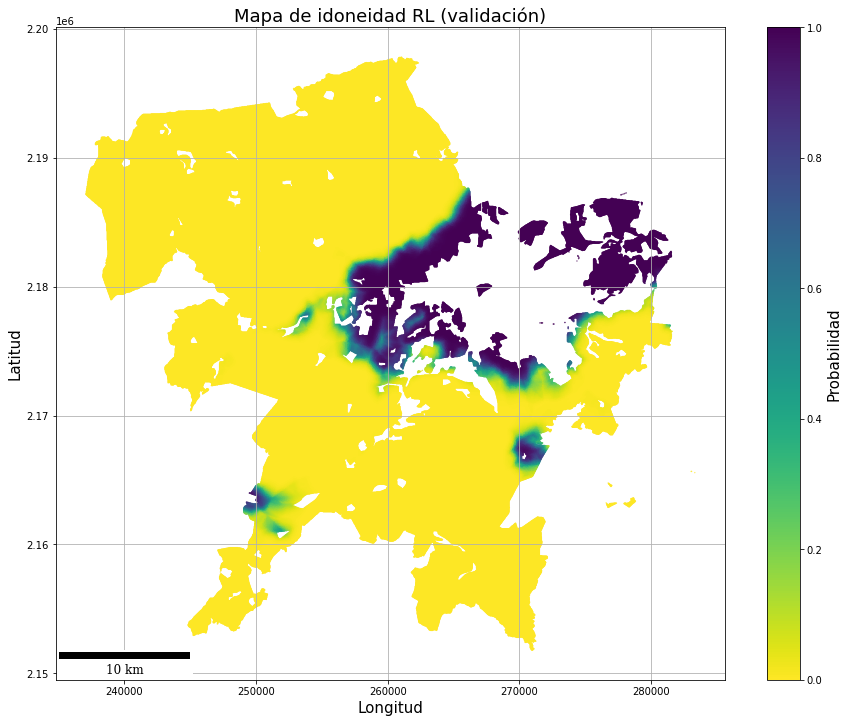

In [113]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(geodata['Lat'], geodata['Lon'], c=geodata['Proba_1_lin'], cmap='viridis_r',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Probabilidad',fontsize=15)
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de idoneidad RL (validación)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

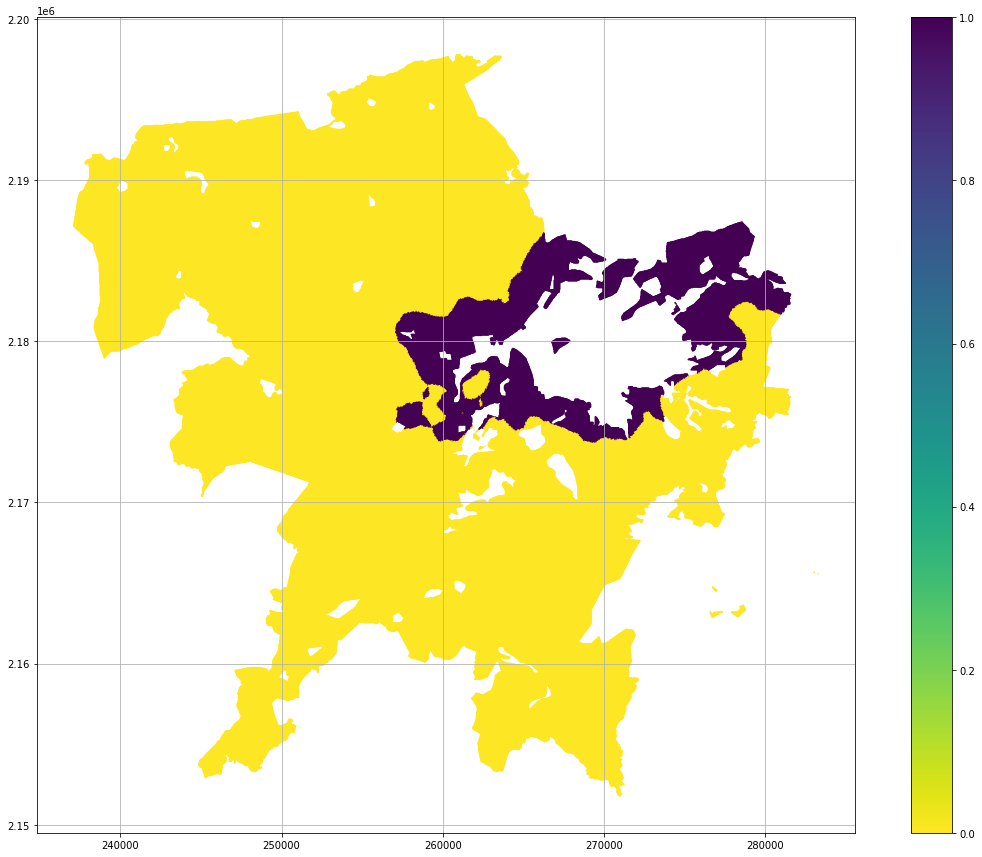

In [114]:
geodata_train.plot(figsize=(20, 15),column=geodata_train['Pred_lin'], cmap="viridis_r",legend=True,s=0.2)
plt.grid()

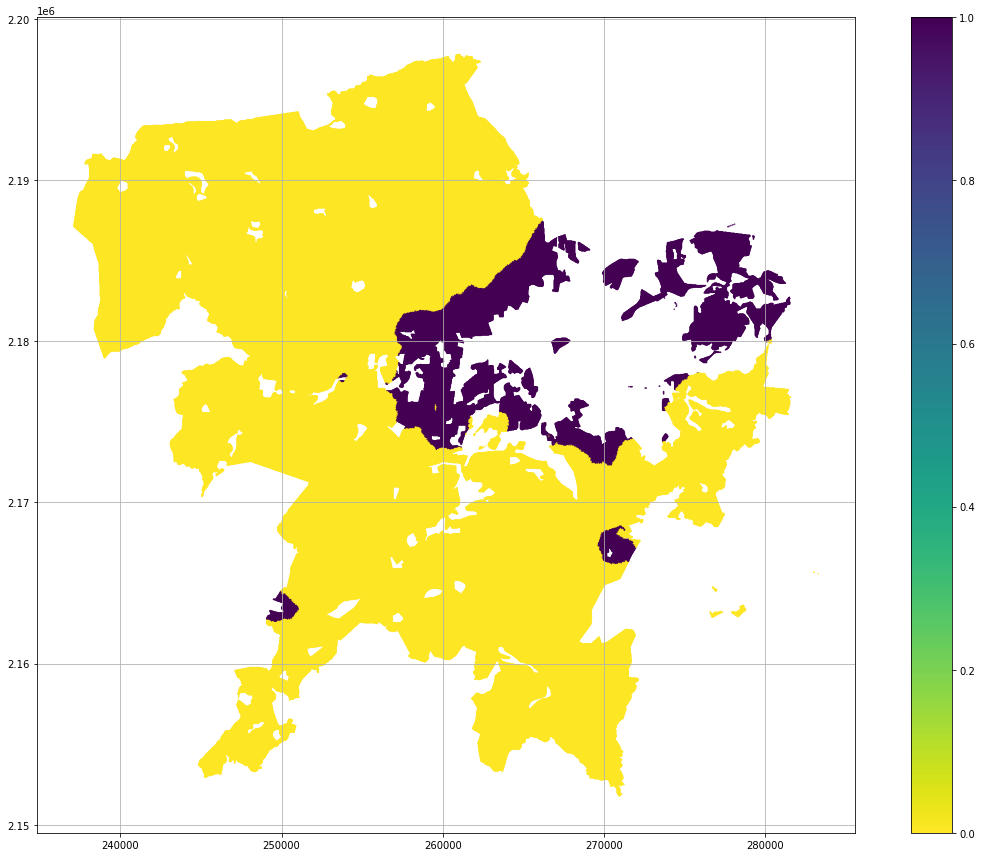

In [115]:
geodata.plot(figsize=(20, 15),column=geodata['Pred_lin'], cmap="viridis_r",legend=True,s=0.2)
plt.grid()

In [116]:
geodata = geodata.reindex(columns = geodata.columns.tolist() + ["color_lin"])

In [117]:
geodata_train = geodata_train.reindex(columns = geodata_train.columns.tolist() + ["color_lin"])

In [118]:
geodata.loc[(geodata["True"]==1) & (geodata["Pred_lin"]==1),"color_lin"]="TP"
geodata.loc[(geodata["True"]==0) & (geodata["Pred_lin"]==0),"color_lin"]="TN"
geodata.loc[(geodata["True"]==1) & (geodata["Pred_lin"]==0),"color_lin"]="FN"
geodata.loc[(geodata["True"]==0) & (geodata["Pred_lin"]==1),"color_lin"]="FP"

In [119]:
geodata_train.loc[(geodata_train["True"]==1) & (geodata_train["Pred_lin"]==1),"color_lin"]="TP"
geodata_train.loc[(geodata_train["True"]==0) & (geodata_train["Pred_lin"]==0),"color_lin"]="TN"
geodata_train.loc[(geodata_train["True"]==1) & (geodata_train["Pred_lin"]==0),"color_lin"]="FN"
geodata_train.loc[(geodata_train["True"]==0) & (geodata_train["Pred_lin"]==1),"color_lin"]="FP"

In [120]:
pointsPalette = {'TP': 'red',
                 'TN': 'gray', 
                 'FP': 'yellow', 
                 'FN': 'blue' 
                }

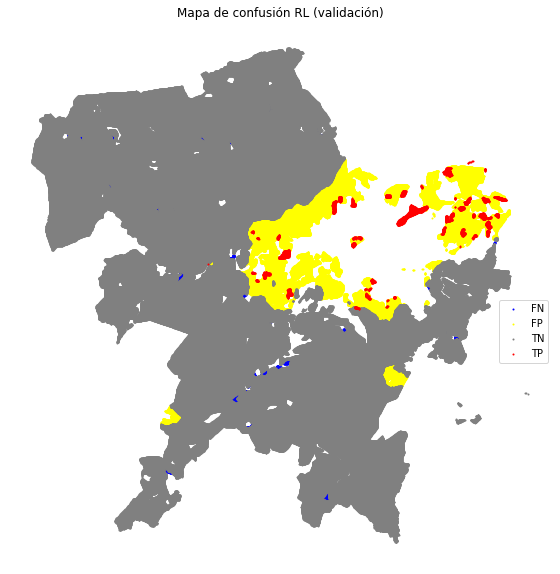

In [121]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in geodata.groupby('color_lin'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión RL (validación)')

ax.set_axis_off()
plt.show()

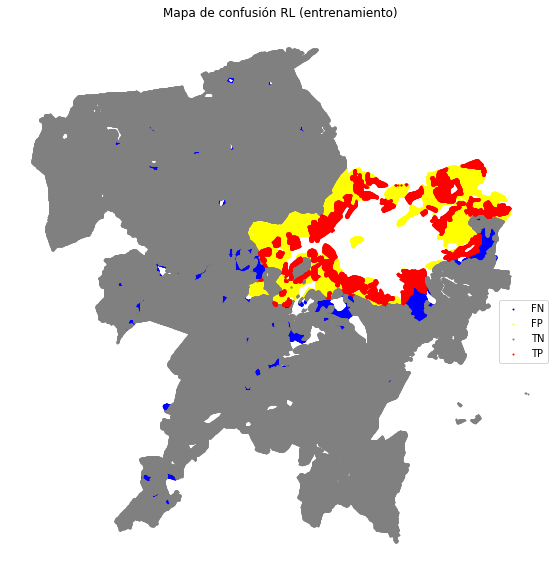

In [122]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in geodata_train.groupby('color_lin'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión RL (entrenamiento)')

ax.set_axis_off()
plt.show()

In [123]:
geodata["color_lin"].value_counts()

color_lin
TN    888233
FP    103908
TP      5739
FN      4114
Name: count, dtype: int64

In [124]:
geodata_train["color_lin"].value_counts()

color_lin
TN    922203
FP     78858
TP     45464
FN     35203
Name: count, dtype: int64

### Pred MLP

In [125]:
acomodados=geodata.sort_values(by='Proba_1_mlp',ascending=False)

In [126]:
 for i in range(9853):
    acomodados.at[acomodados.index[i],'Categoria']=1

In [127]:
acomodados['Categoria'] =  acomodados['Categoria'].fillna(0)

In [128]:
acomodados

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon,geometry,color,color_lin,Categoria
580814,0.338551,2401.844181,7670.415074,1671.288467,29.996871,6227.975366,59.993741,10.088930,0,0.999408,1.0,9.999691e-01,1.0,0.0,264138.112108,2.178537e+06,POINT (264138.112 2178537.268),FP,FP,1.0
581964,0.331906,2372.617067,7640.839319,1660.751077,29.996871,6235.559861,59.993741,10.124940,0,0.999408,1.0,9.999670e-01,1.0,0.0,264138.112108,2.178507e+06,POINT (264138.112 2178507.263),FP,FP,1.0
579671,0.342643,2431.090241,7699.994147,1682.295071,29.996871,6220.526353,59.993741,10.052921,0,0.999407,1.0,9.999711e-01,1.0,0.0,264138.112108,2.178567e+06,POINT (264138.112 2178567.272),FP,FP,1.0
583122,0.323586,2343.409606,7611.266923,1650.691886,29.996871,6243.279344,59.993741,10.160949,0,0.999406,1.0,9.999648e-01,1.0,0.0,264138.112108,2.178477e+06,POINT (264138.112 2178477.258),FP,FP,1.0
578538,0.343340,2460.354571,7729.576501,1693.761742,29.996871,6213.213308,59.993741,10.016912,0,0.999406,1.0,9.999730e-01,1.0,0.0,264138.112108,2.178597e+06,POINT (264138.112 2178597.277),FP,FP,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
339478,23.977619,8808.662482,10563.525813,0.000000,3615.575674,11561.663911,2352.414037,53.011890,0,0.000047,0.0,9.609158e-07,0.0,0.0,259338.612824,2.184148e+06,POINT (259338.613 2184148.147),TN,TN,0.0
340850,27.867977,8769.744656,10604.686706,0.000000,3596.096376,11523.069551,2394.508060,52.502707,0,0.000047,0.0,1.426081e-06,0.0,0.0,259368.609695,2.184118e+06,POINT (259368.610 2184118.142),TN,TN,0.0
1324076,11.851118,9502.779132,4374.282757,0.000000,11018.023912,27609.434401,2513.497187,68.786911,0,0.000047,0.0,1.288495e-23,0.0,0.0,263388.190345,2.153333e+06,POINT (263388.190 2153333.318),TN,TN,0.0
1324078,6.007709,9324.559581,4235.174087,0.000000,11200.294047,27530.272043,2550.399612,67.929796,0,0.000046,0.0,1.225880e-23,0.0,0.0,263718.155921,2.153333e+06,POINT (263718.156 2153333.318),TN,TN,0.0


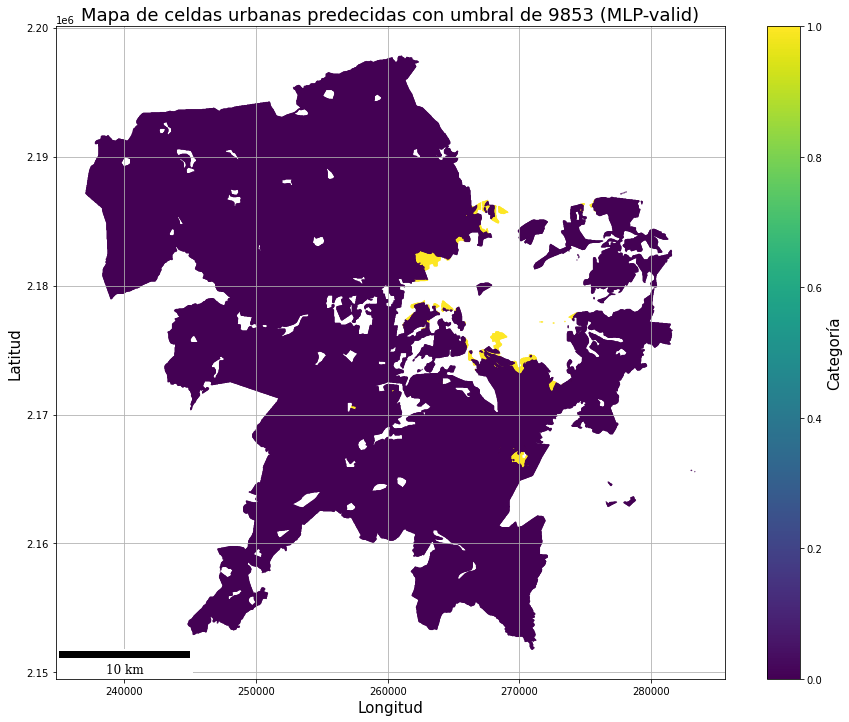

In [129]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(acomodados['Lat'], acomodados['Lon'], c=acomodados['Categoria'], cmap='viridis',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Categoría',fontsize=15)
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de celdas urbanas predecidas con umbral de 9853 (MLP-valid)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

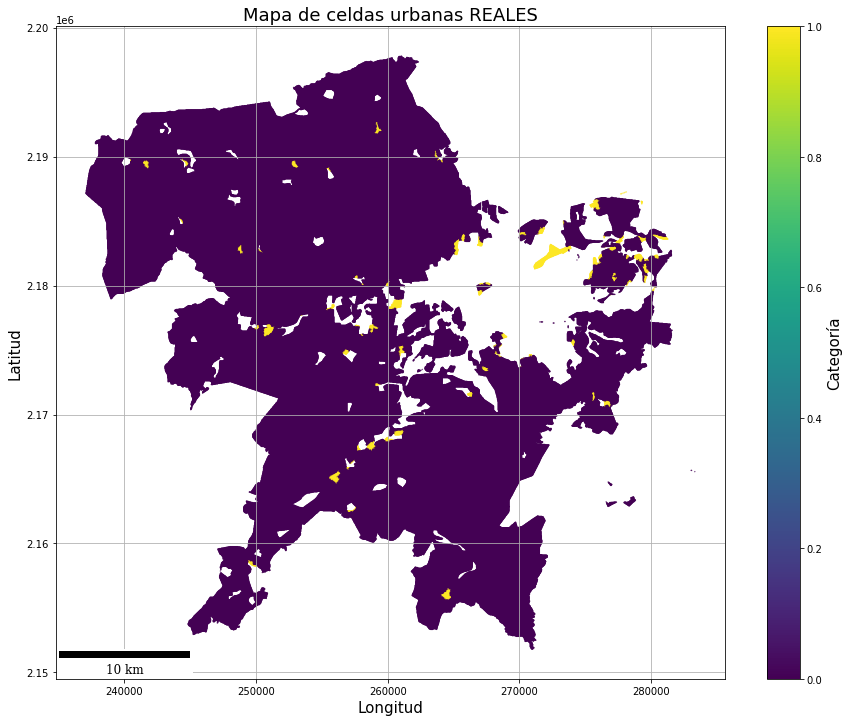

In [130]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(acomodados['Lat'], acomodados['Lon'], c=acomodados['diferencia'], cmap='viridis',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Categoría',fontsize=15)
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de celdas urbanas REALES",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

In [131]:
acomodados.loc[(acomodados["True"]==1) & (acomodados["Categoria"]==1),"color_umbral"]="TP"
acomodados.loc[(acomodados["True"]==0) & (acomodados["Categoria"]==0),"color_umbral"]="TN"
acomodados.loc[(acomodados["True"]==1) & (acomodados["Categoria"]==0),"color_umbral"]="FN"
acomodados.loc[(acomodados["True"]==0) & (acomodados["Categoria"]==1),"color_umbral"]="FP"

In [132]:
pointsPalette = {'TP': 'red',
                 'TN': 'gray', 
                 'FP': 'blue', 
                 'FN': 'yellow' 
                }

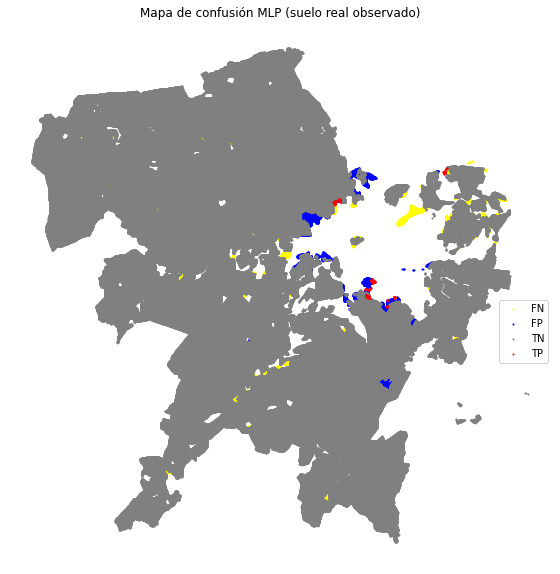

In [133]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in acomodados.groupby('color_umbral'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión MLP (suelo real observado)')

ax.set_axis_off()
plt.show()

In [134]:
acomodados["color_umbral"].value_counts()

color_umbral
TN    982603
FP      9538
FN      9538
TP       315
Name: count, dtype: int64

In [135]:
9283+570

9853

In [136]:
9065+788

9853

##### Mapa de confusión para el umbral real

In [137]:
for i in range(3956):
    acomodados.at[acomodados.index[i],'Categoria_c']=2019

In [138]:
for i in range(3956,3956*2):
    acomodados.at[acomodados.index[i],'Categoria_c']=2020

In [139]:
for i in range(3956*2,3956*3):
    acomodados.at[acomodados.index[i],'Categoria_c']=2021

In [140]:
for i in range(3956*3,3956*4):
    acomodados.at[acomodados.index[i],'Categoria_c']=2022

In [141]:
for i in range(3956*4,3956*5):
    acomodados.at[acomodados.index[i],'Categoria_c']=2023

In [142]:
for i in range(3956*5,3956*6):
    acomodados.at[acomodados.index[i],'Categoria_c']=2024

In [143]:
for i in range(3956*6,3956*7):
    acomodados.at[acomodados.index[i],'Categoria_c']=2025

In [144]:
for i in range(3956*7,3956*8):
    acomodados.at[acomodados.index[i],'Categoria_c']=2026

In [145]:
for i in range(3956*8,3956*9):
    acomodados.at[acomodados.index[i],'Categoria_c']=2027

In [147]:
acomodados['Categoria_c'] =  acomodados['Categoria_c'].fillna(0)

In [148]:
pointsPalette = {2019: 'yellow',
                 2020: 'yellow', 
                 2021: 'yellow',
                 2022: 'blue',
                 2023: 'blue',
                 2024: 'blue',
                 2025: 'green',
                 2026: 'green',
                 2027: 'green',
                 0: 'gray'
                }

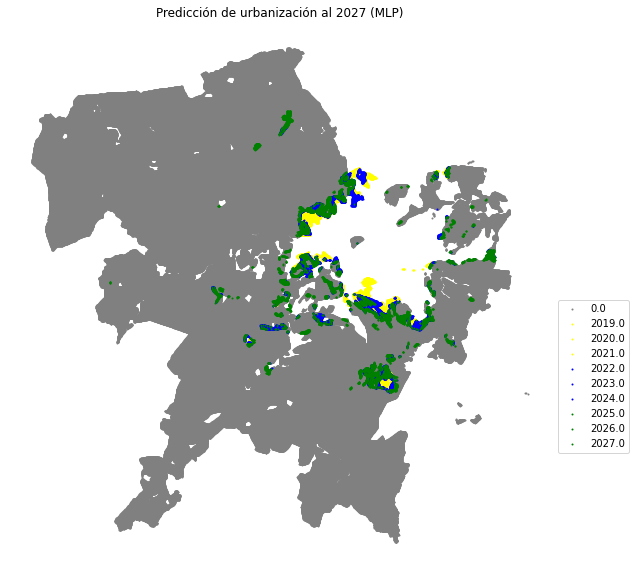

In [149]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in acomodados.groupby('Categoria_c'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Predicción de urbanización al 2027 (MLP)')

ax.set_axis_off()
plt.show()

In [171]:
acomodados

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,...,Pred_lin,True,Lat,Lon,geometry,color,color_lin,Categoria,color_umbral,Categoria_c
267380,8.969501,3547.410711,10891.706580,7076.354793,752.348912,9243.916603,120.018805,16.957993,0,0.130273,...,1.0,0.0,277396.728880,2.185858e+06,POINT (277396.729 2185858.415),TN,FP,1.0,FP,2019.0
323908,15.635604,3288.611903,9541.919384,5890.547693,212.111013,8366.346258,359.962446,16.746715,0,0.129737,...,1.0,0.0,277276.741398,2.184508e+06,POINT (277276.741 2184508.203),TN,FP,1.0,FP,2019.0
286606,0.562959,4684.222937,10477.150470,6268.034757,745.220620,9946.718693,299.968705,18.639772,0,0.438014,...,1.0,0.0,278596.603701,2.185378e+06,POINT (278596.604 2185378.339),TN,FP,1.0,FP,2019.0
249756,1.826889,2970.387548,11362.742118,6658.063932,666.152888,8997.079881,0.000000,15.929368,0,0.438589,...,1.0,0.0,276676.803988,2.186308e+06,POINT (276676.804 2186308.485),TN,FP,1.0,FP,2019.0
338618,9.934905,1116.566653,9651.080633,6231.872391,94.860910,5942.232273,749.921763,21.206619,0,0.045463,...,1.0,0.0,274487.032439,2.184178e+06,POINT (274487.032 2184178.151),TN,FP,1.0,FP,2019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
509106,20.870979,23288.394330,10944.756786,0.000000,6061.095447,31648.120767,2466.536070,119.657828,0,0.000599,...,0.0,0.0,238520.784680,2.180398e+06,POINT (238520.785 2180397.559),TN,TN,0.0,TN,0.0
502762,28.686102,23392.835476,10862.127842,0.000000,6024.195239,31709.886317,2562.986539,119.631912,0,0.000599,...,0.0,0.0,238460.790939,2.180548e+06,POINT (238460.791 2180547.583),TN,TN,0.0,TN,0.0
511629,25.924519,23241.101799,10974.707879,0.000000,6072.163840,31617.612716,2424.027583,119.596195,0,0.000599,...,0.0,0.0,238550.781551,2.180338e+06,POINT (238550.782 2180337.550),TN,TN,0.0,TN,0.0
512872,28.326500,23231.745018,10998.758049,0.000000,6090.003422,31617.399160,2417.891730,119.563225,0,0.000647,...,0.0,0.0,238550.781551,2.180308e+06,POINT (238550.782 2180307.545),TN,TN,0.0,TN,0.0


In [192]:
lon1, lat1 = myProj(simulate["Lat"], simulate["Lon"], inverse=True)

In [198]:
tile_url = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'

m1=folium.Map(location=[19.70078, -101.18443], tiles=tile_url, zoom_start=12, attr='Esri',overlay=False, control=True)
#location=location[0:2000]
for lat,lon,val in zip(lat1, lon1,simulate["Categoria_c"]):
     folium.CircleMarker([lat, lon],
                            radius=2,
                            color=False,
                            fill_color=colormap(val),
                            fill=True,
                            fill_opacity=0.2
                           ).add_to(m1)
        


m1

In [188]:
simulate=acomodados[acomodados["Categoria_c"]>0]

In [190]:
simulate["Categoria_c"]

267380    2019.0
323908    2019.0
286606    2019.0
249756    2019.0
338618    2019.0
           ...  
263624    2027.0
289982    2027.0
282746    2027.0
511462    2027.0
499542    2027.0
Name: Categoria_c, Length: 35604, dtype: float64

### Pred Linear

In [150]:
acomodados=geodata.sort_values(by='Proba_1_lin',ascending=False)

In [151]:
 for i in range(9853):
    acomodados.at[acomodados.index[i],'Categoria']=1

In [152]:
acomodados['Categoria'] =  acomodados['Categoria'].fillna(0)

In [153]:
acomodados

,pendiente,dist_anps,dist_agua,dist_vegetacion,dist_urbano,dist_centro,dist_vial,coste,diferencia,Proba_1_mlp,Pred_mlp,Proba_1_lin,Pred_lin,True,Lat,Lon,geometry,color,color_lin,Categoria
267380,8.969501,3547.410711,10891.706580,7076.354793,752.348912,9243.916603,120.018805,16.957993,0,0.130273,0.0,1.000000e+00,1.0,0.0,277396.728880,2.185858e+06,POINT (277396.729 2185858.415),TN,FP,1.0
323908,15.635604,3288.611903,9541.919384,5890.547693,212.111013,8366.346258,359.962446,16.746715,0,0.129737,0.0,1.000000e+00,1.0,0.0,277276.741398,2.184508e+06,POINT (277276.741 2184508.203),TN,FP,1.0
286606,0.562959,4684.222937,10477.150470,6268.034757,745.220620,9946.718693,299.968705,18.639772,0,0.438014,0.0,1.000000e+00,1.0,0.0,278596.603701,2.185378e+06,POINT (278596.604 2185378.339),TN,FP,1.0
249756,1.826889,2970.387548,11362.742118,6658.063932,666.152888,8997.079881,0.000000,15.929368,0,0.438589,0.0,1.000000e+00,1.0,0.0,276676.803988,2.186308e+06,POINT (276676.804 2186308.485),TN,FP,1.0
338618,9.934905,1116.566653,9651.080633,6231.872391,94.860910,5942.232273,749.921763,21.206619,0,0.045463,0.0,1.000000e+00,1.0,0.0,274487.032439,2.184178e+06,POINT (274487.032 2184178.151),TN,FP,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
509106,20.870979,23288.394330,10944.756786,0.000000,6061.095447,31648.120767,2466.536070,119.657828,0,0.000599,0.0,2.060199e-27,0.0,0.0,238520.784680,2.180398e+06,POINT (238520.785 2180397.559),TN,TN,0.0
502762,28.686102,23392.835476,10862.127842,0.000000,6024.195239,31709.886317,2562.986539,119.631912,0,0.000599,0.0,2.035599e-27,0.0,0.0,238460.790939,2.180548e+06,POINT (238460.791 2180547.583),TN,TN,0.0
511629,25.924519,23241.101799,10974.707879,0.000000,6072.163840,31617.612716,2424.027583,119.596195,0,0.000599,0.0,2.014395e-27,0.0,0.0,238550.781551,2.180338e+06,POINT (238550.782 2180337.550),TN,TN,0.0
512872,28.326500,23231.745018,10998.758049,0.000000,6090.003422,31617.399160,2417.891730,119.563225,0,0.000647,0.0,1.999100e-27,0.0,0.0,238550.781551,2.180308e+06,POINT (238550.782 2180307.545),TN,TN,0.0


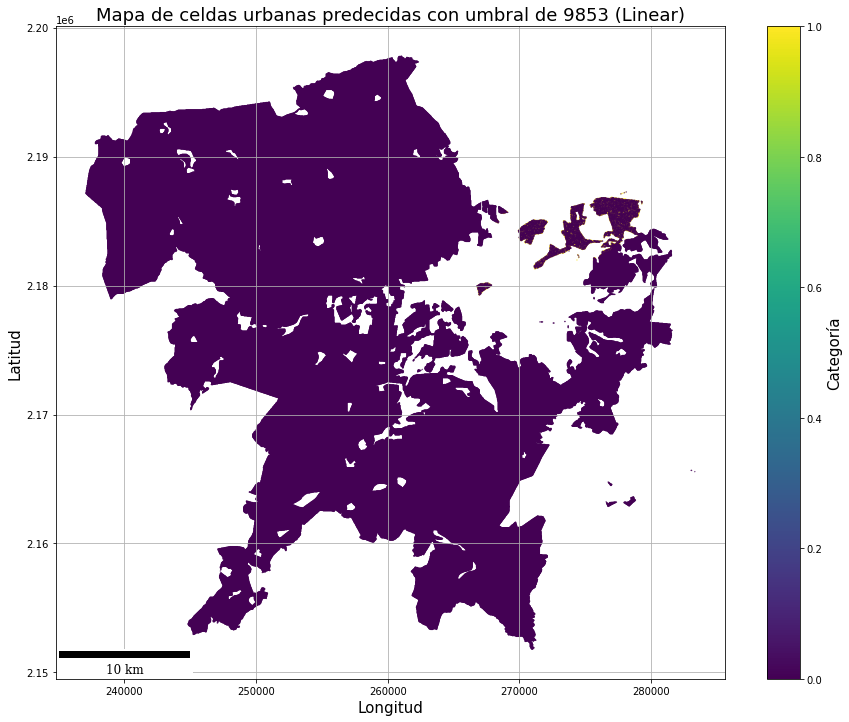

In [154]:
# Create a continuous plot with a colorbar
fig, ax = plt.subplots(figsize=(15, 12))
c = ax.scatter(acomodados['Lat'], acomodados['Lon'], c=acomodados['Categoria'], cmap='viridis',s=0.1)
#plt.colorbar(c)

# Add a label to the colorbar
cb = plt.colorbar(c)
cb.set_label('Categoría',fontsize=15)
plt.grid()
ax.add_artist(ScaleBar(
    dx=1,
    units="m",
    dimension="si-length",
    length_fraction=0.25,
    font_properties={'family':'serif', 'size': 'large'},
    #scale_formatter=lambda value, unit: f' {value * 1000} km ',
    location='lower left'
))
plt.title("Mapa de celdas urbanas predecidas con umbral de 9853 (Linear)",fontsize=18)
plt.xlabel('Longitud',fontsize=15)
plt.ylabel('Latitud',fontsize=15)
# Show the plot
plt.show()

In [155]:
acomodados.loc[(acomodados["True"]==1) & (acomodados["Categoria"]==1),"color_umbral"]="TP"
acomodados.loc[(acomodados["True"]==0) & (acomodados["Categoria"]==0),"color_umbral"]="TN"
acomodados.loc[(acomodados["True"]==1) & (acomodados["Categoria"]==0),"color_umbral"]="FN"
acomodados.loc[(acomodados["True"]==0) & (acomodados["Categoria"]==1),"color_umbral"]="FP"

In [156]:
pointsPalette = {'TP': 'red',
                 'TN': 'gray', 
                 'FP': 'blue', 
                 'FN': 'yellow' 
                }

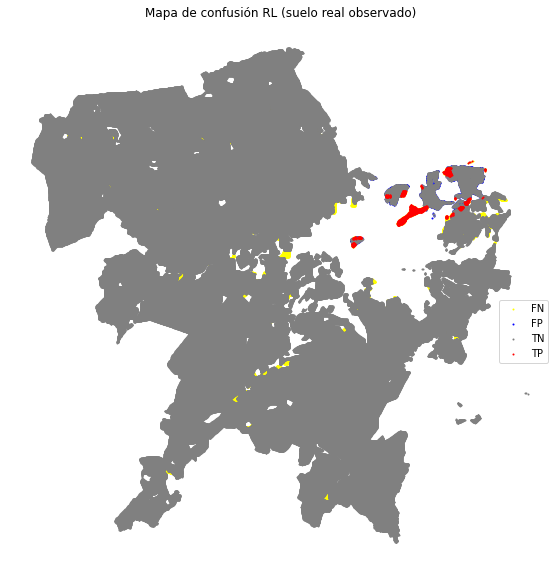

In [157]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in acomodados.groupby('color_umbral'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Mapa de confusión RL (suelo real observado)')

ax.set_axis_off()
plt.show()

In [158]:
acomodados["color_umbral"].value_counts()

color_umbral
TN    983729
FP      8412
FN      8412
TP      1441
Name: count, dtype: int64

In [160]:
9799+54

9853

In [161]:
9550+303

9853

In [159]:
for i in range(3956):
    acomodados.at[acomodados.index[i],'Categoria_c']=2019

In [160]:
for i in range(3956,3956*2):
    acomodados.at[acomodados.index[i],'Categoria_c']=2020

In [161]:
for i in range(3956*2,3956*3):
    acomodados.at[acomodados.index[i],'Categoria_c']=2021

In [162]:
for i in range(3956*3,3956*4):
    acomodados.at[acomodados.index[i],'Categoria_c']=2022

In [163]:
for i in range(3956*4,3956*5):
    acomodados.at[acomodados.index[i],'Categoria_c']=2023

In [164]:
for i in range(3956*5,3956*6):
    acomodados.at[acomodados.index[i],'Categoria_c']=2024

In [165]:
for i in range(3956*6,3956*7):
    acomodados.at[acomodados.index[i],'Categoria_c']=2025

In [166]:
for i in range(3956*7,3956*8):
    acomodados.at[acomodados.index[i],'Categoria_c']=2026

In [167]:
for i in range(3956*8,3956*9):
    acomodados.at[acomodados.index[i],'Categoria_c']=2027

In [168]:
acomodados['Categoria_c'] =  acomodados['Categoria_c'].fillna(0)

In [169]:
pointsPalette = {2019: 'yellow',
                 2020: 'yellow', 
                 2021: 'yellow',
                 2022: 'blue',
                 2023: 'blue',
                 2024: 'blue',
                 2025: 'green',
                 2026: 'green',
                 2027: 'green',
                 0: 'gray'
                }

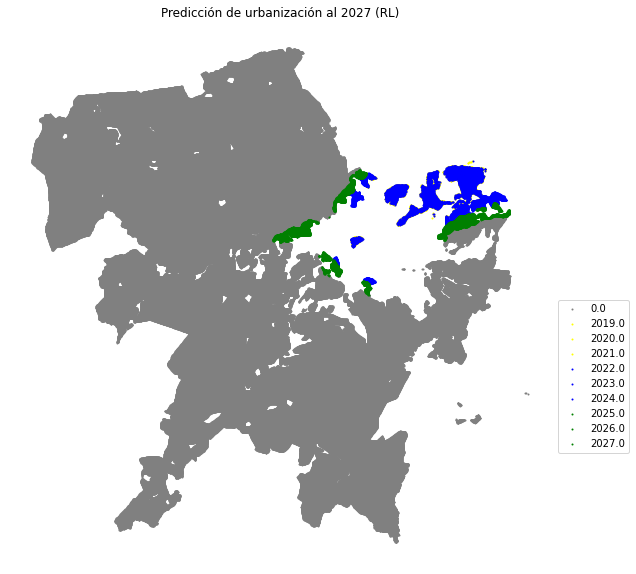

In [170]:
fig, ax = plt.subplots(figsize=(10, 10))


for ctype, data in acomodados.groupby('Categoria_c'):
    color = pointsPalette[ctype]
    label = ctype
    data.plot(color=color,
              ax=ax,
              label=label,
              markersize=1)
    
    
ax.legend(bbox_to_anchor=(1.0, .5), prop={'size': 10})
ax.set(title='Predicción de urbanización al 2027 (RL)')

ax.set_axis_off()
plt.show()